# Looking at the 49ers play-by-play win probabilities

In [230]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.interpolate import make_interp_spline, BSpline

sns.set(style="whitegrid", 
        palette="pastel", 
        font='Circular Spotify Text', 
        font_scale = 1.1, 
        rc= {'grid.color': '.95', 'xtick.color': '.3', 'ytick.color': '.3'})


In [227]:
import matplotlib.font_manager
matplotlib.font_manager.findSystemFonts(fontpaths=None, fontext='ttf')

['/System/Library/Fonts/SFNSDisplayCondensed-Heavy.otf',
 '/System/Library/Fonts/SFNSDisplayCondensed-Light.otf',
 '/Library/Fonts/Courier New.ttf',
 '/Library/Fonts/Brush Script.ttf',
 '/System/Library/Fonts/SFCompactRounded-Medium.otf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Bourton Hand Script Light.ttf',
 '/Users/jaakko/Library/Fonts/Meslo LG M DZ Regular for Powerline.otf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Bourton Hand Stripes A.ttf',
 '/Users/jaakko/Library/Fonts/skyfonts-google/Rajdhani 300.ttf',
 '/Library/Fonts/STIXIntUpReg.otf',
 '/System/Library/Fonts/SFNSDisplay-UltralightItalic.otf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Corporative Black.otf',
 '/Library/Fonts/DIN Alternate Bold.ttf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Texta Alt Medium Italic.otf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Bourton Hand Drop Shadow.ttf',
 '/Users/jaakko/Library/Fonts/skyfonts-myfonts/Bourton Hand Line.ttf',
 '/Users/jaakko/Library/Fonts/skyfo

In [3]:
team_colors = {
    'SF': '#AA0000',
    'KC': '#000000',
    'ARI': '#000000',
    'ATL': '#000000',
    'BAL': '#241773',
    'PHI': '#004953',
    'NYG': '#0B2265',
    'NO': '#9F8958',
    'NE': '#002244',
    'MIN': '#4F2683',
    'MIA': '#008E97',
    'IND': '#002C5F',
    'CLE': '#FB4F14',
    'LAC': '#002244',
    'DEN': '#002244',
    'CAR': '#0085CA',
    'GB': '#203731',
    'DET': '#005A8B',
    'OAK': '#A5ACAF',
    'CIN': '#FB4F14',
    'WAS': '#773141',
    'TEN': '#002244',
    'TB': '#000000',
    'PIT': '#FFB612',
    'NYJ': '#203731',
    'BUF': '#00338D',
    'LA': '#002244',
    'JAX': '#006778',
    'DAL': '#002244',
    'CHI': '#0B162A',
    'HOU': '#03202F',
    'SEA': '#002244'
}

team_colors_main = {
    'SF': '#AA0000',
    'KC': '#E31837',
    'ARI': '#97233F',
    'ATL': '#A71930',
    'BAL': '#241773',
    'PHI': '#004953',
    'NYG': '#0B2265',
    'NO': '#9F8958',
    'NE': '#002244',
    'MIN': '#4F2683',
    'MIA': '#008E97',
    'IND': '#002C5F',
    'CLE': '#FB4F14',
    'LAC': '#002244',
    'DEN': '#002244',
    'CAR': '#0085CA',
    'GB': '#203731',
    'DET': '#005A8B',
    'OAK': '#A5ACAF',
    'CIN': '#FB4F14',
    'WAS': '#773141',
    'TEN': '#002244',
    'TB': '#D50A0A',
    'PIT': '#FFB612',
    'NYJ': '#203731',
    'BUF': '#00338D',
    'LA': '#002244',
    'JAX': '#006778',
    'DAL': '#002244',
    'CHI': '#0B162A',
    'HOU': '#03202F',
    'SEA': '#002244'
}

team_colors_gray = {
    
    'SF': '#AA0000',
    'KC': '#D9D9D9',
    'ARI': '#D9D9D9',
    'ATL': '#D9D9D9',
    'BAL': '#D9D9D9',
    'PHI': '#D9D9D9',
    'NYG': '#D9D9D9',
    'NO': '#D9D9D9',
    'NE': '#D9D9D9',
    'MIN': '#D9D9D9',
    'MIA': '#D9D9D9',
    'IND': '#D9D9D9',
    'CLE': '#D9D9D9',
    'LAC': '#D9D9D9',
    'DEN': '#D9D9D9',
    'CAR': '#D9D9D9',
    'GB': '#D9D9D9',
    'DET': '#D9D9D9',
    'OAK': '#D9D9D9',
    'CIN': '#D9D9D9',
    'WAS': '#D9D9D9',
    'TEN': '#D9D9D9',
    'TB': '#D9D9D9',
    'PIT': '#D9D9D9',
    'NYJ': '#D9D9D9',
    'BUF': '#D9D9D9',
    'LA': '#D9D9D9',
    'JAX': '#D9D9D9',
    'DAL': '#D9D9D9',
    'CHI': '#D9D9D9',
    'HOU': '#D9D9D9',
    'SEA': '#D9D9D9'
}

## Reading Play-by-play data

In [4]:
df = pd.read_csv("../data/reg_pbp_2018.csv")

/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (42,167,168,169,170,179,180,183,184,189,190,191,192,199,200,201,202,203,204,205,206,208,210,212,227,228,229,230,231,232,233,234,235,237,238,239,241,242,250) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
df.head()

,play_id,game_id,home_team,away_team,posteam,posteam_type,defteam,side_of_field,yardline_100,game_date,...,penalty_player_id,penalty_player_name,penalty_yards,replay_or_challenge,replay_or_challenge_result,penalty_type,defensive_two_point_attempt,defensive_two_point_conv,defensive_extra_point_attempt,defensive_extra_point_conv
0,37,2018090600,PHI,ATL,ATL,away,PHI,PHI,35.0,2018-09-06,...,NaN,NaN,NaN,0,NaN,NaN,0.0,0.0,0.0,0.0
1,52,2018090600,PHI,ATL,ATL,away,PHI,ATL,75.0,2018-09-06,...,00-0027215,L.Paulsen,5.0,0,NaN,False Start,0.0,0.0,0.0,0.0
2,75,2018090600,PHI,ATL,ATL,away,PHI,ATL,80.0,2018-09-06,...,NaN,NaN,NaN,0,NaN,NaN,0.0,0.0,0.0,0.0
3,104,2018090600,PHI,ATL,ATL,away,PHI,ATL,70.0,2018-09-06,...,NaN,NaN,NaN,0,NaN,NaN,0.0,0.0,0.0,0.0
4,125,2018090600,PHI,ATL,ATL,away,PHI,ATL,59.0,2018-09-06,...,NaN,NaN,NaN,0,NaN,NaN,0.0,0.0,0.0,0.0


In [6]:
list(df.columns)

['play_id',
 'game_id',
 'home_team',
 'away_team',
 'posteam',
 'posteam_type',
 'defteam',
 'side_of_field',
 'yardline_100',
 'game_date',
 'quarter_seconds_remaining',
 'half_seconds_remaining',
 'game_seconds_remaining',
 'game_half',
 'quarter_end',
 'drive',
 'sp',
 'qtr',
 'down',
 'goal_to_go',
 'time',
 'yrdln',
 'ydstogo',
 'ydsnet',
 'desc',
 'play_type',
 'yards_gained',
 'shotgun',
 'no_huddle',
 'qb_dropback',
 'qb_kneel',
 'qb_spike',
 'qb_scramble',
 'pass_length',
 'pass_location',
 'air_yards',
 'yards_after_catch',
 'run_location',
 'run_gap',
 'field_goal_result',
 'kick_distance',
 'extra_point_result',
 'two_point_conv_result',
 'home_timeouts_remaining',
 'away_timeouts_remaining',
 'timeout',
 'timeout_team',
 'td_team',
 'posteam_timeouts_remaining',
 'defteam_timeouts_remaining',
 'total_home_score',
 'total_away_score',
 'posteam_score',
 'defteam_score',
 'score_differential',
 'posteam_score_post',
 'defteam_score_post',
 'score_differential_post',
 'no_sc

In [94]:
# Getting all the game ID's for San Francisco's games
sf_schedule = (
    df[(df['home_team'] == 'SF') | (df['away_team'] == 'SF')]
        .groupby(['game_date', 'game_id', 'away_team', 'home_team'])
        [['total_away_score','total_home_score']]
        .max()
        .reset_index()
        .sort_values('game_date')
)

sf_schedule

,game_date,game_id,away_team,home_team,total_away_score,total_home_score
0,2018-09-09,2018090904,SF,MIN,16,23
1,2018-09-16,2018091610,DET,SF,27,30
2,2018-09-23,2018092305,SF,KC,27,38
3,2018-09-30,2018093010,SF,LAC,26,29
4,2018-10-07,2018100710,ARI,SF,27,18
5,2018-10-15,2018101500,SF,GB,30,33
6,2018-10-21,2018102111,LA,SF,39,10
7,2018-10-28,2018102809,SF,ARI,15,18
8,2018-11-01,2018110100,OAK,SF,3,34
9,2018-11-12,2018111200,NYG,SF,27,23


## Plotting SFs win probability charts

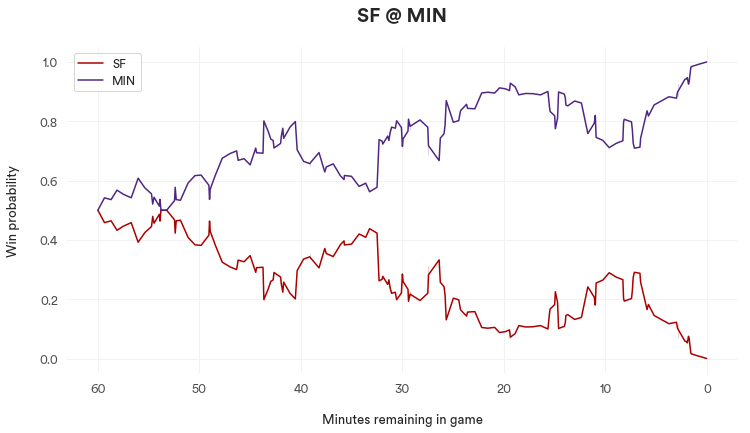

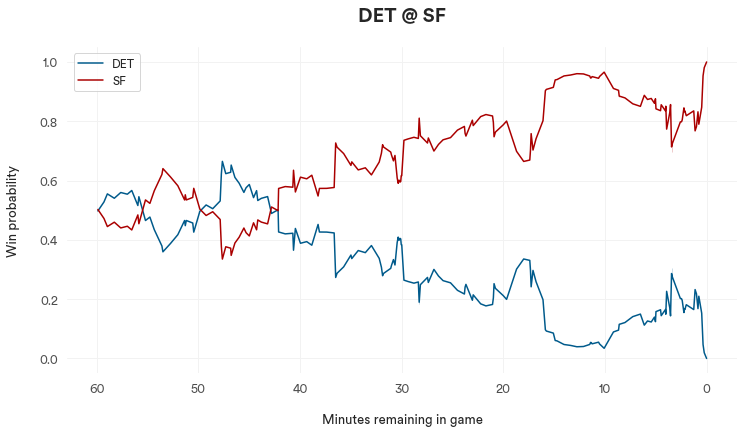

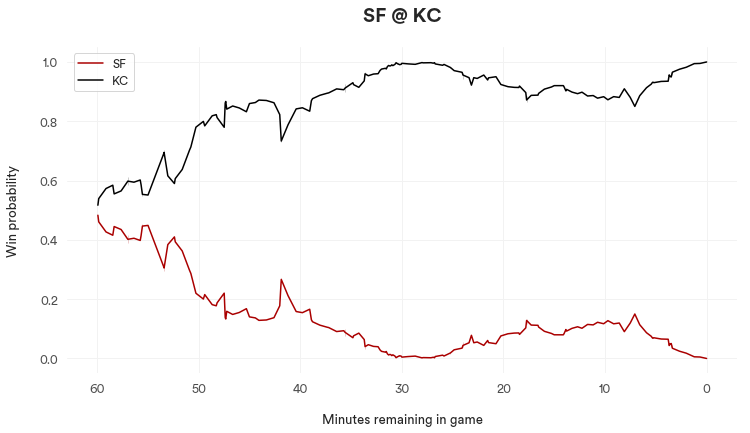

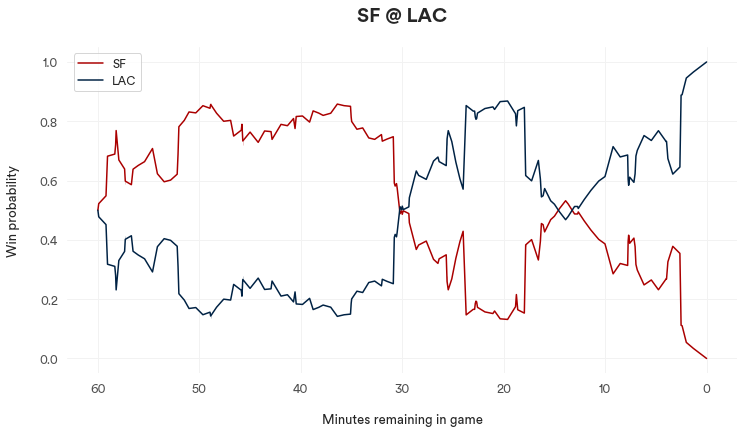

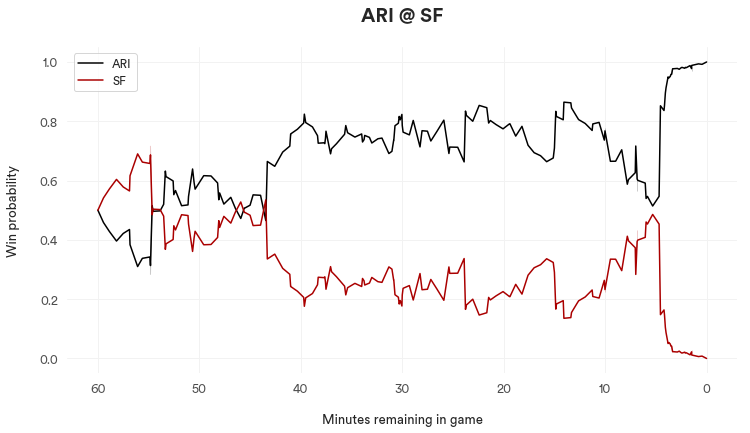

...

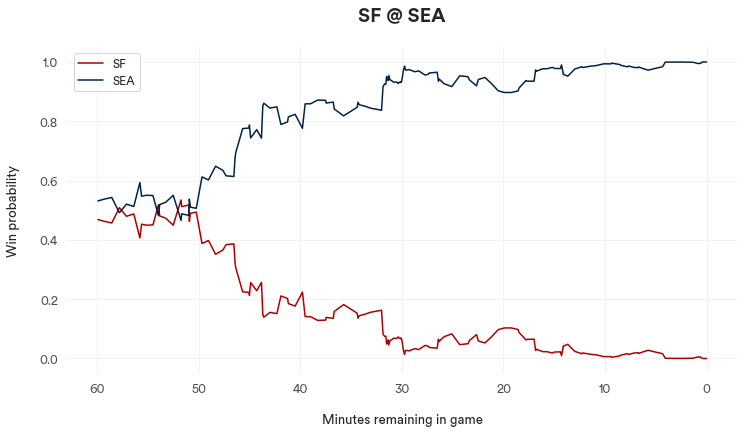

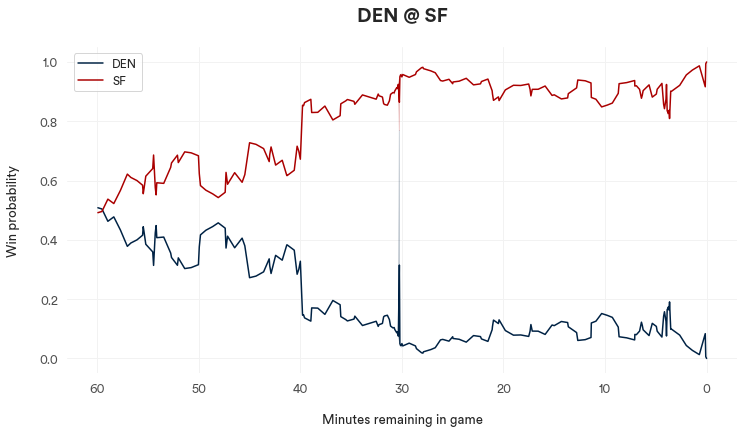

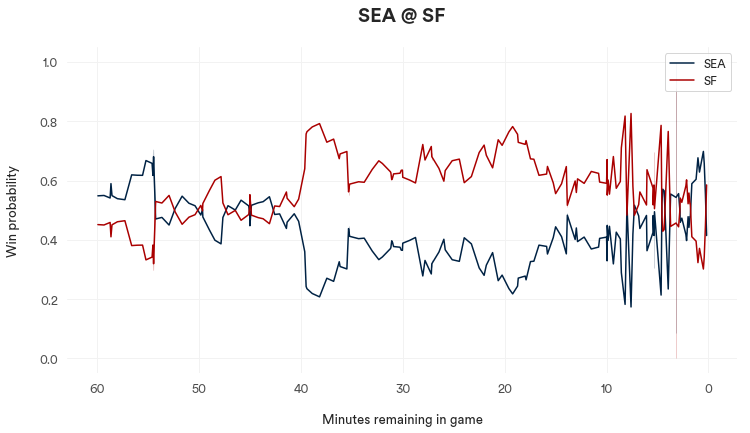

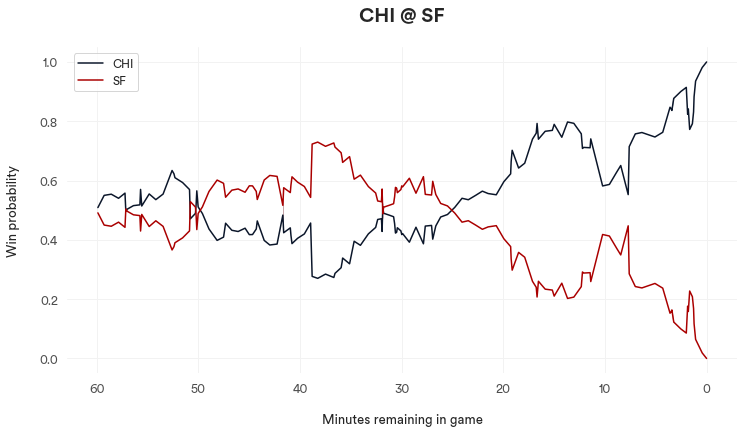

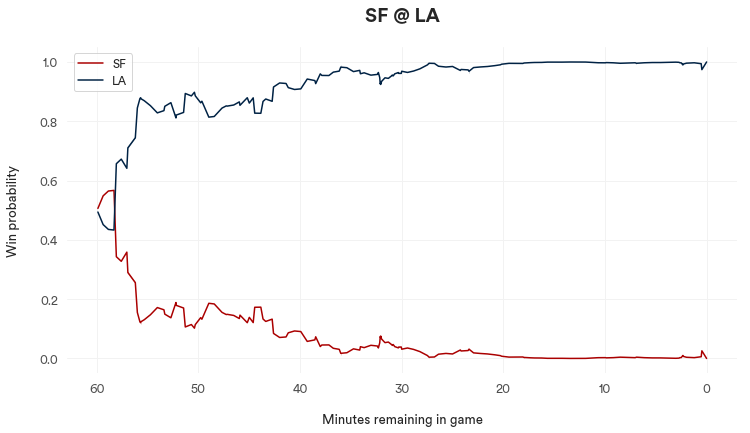

In [194]:
# Looping through SFs game IDs, pulling home team and away team to use as column names and pull correct team colors

game_ids = list(sf_schedule['game_id'])

for g, game in enumerate(game_ids):
    
    home_team, away_team = sf_schedule[sf_schedule['game_id'] == game][['home_team', 'away_team']].values[0]
    
    win_probs = (df[df['game_id'] == game][['away_wp', 'home_wp', 'game_seconds_remaining']]
                 .rename(columns={'home_wp': home_team, 'away_wp': away_team, 'game_seconds_remaining': 'game_minutes_remaining'}))
    
    win_probs['game_minutes_remaining'] = win_probs['game_minutes_remaining']/60
    win_probs = win_probs.set_index('game_minutes_remaining')
    
    
    f, ax = plt.subplots(figsize=(12, 6))
    ax = sns.lineplot(data=win_probs, dashes=False, palette=team_colors)
    
    ax.set_title('{} @ {}\n'.format(away_team, home_team), fontsize=20, weight='bold')
    ax.set_ylabel('Win probability\n')
    ax.set_xlabel('\nMinutes remaining in game')
    
    ax.invert_xaxis()
    
    sns.despine(left=True, right=True, bottom=True, top=True)
    
    filename = str(away_team + '_at_' + home_team)
    
    plt.savefig('output/sf/' + filename + '.png', format='png', dpi=300)
    
    

### Smoothing with splines!

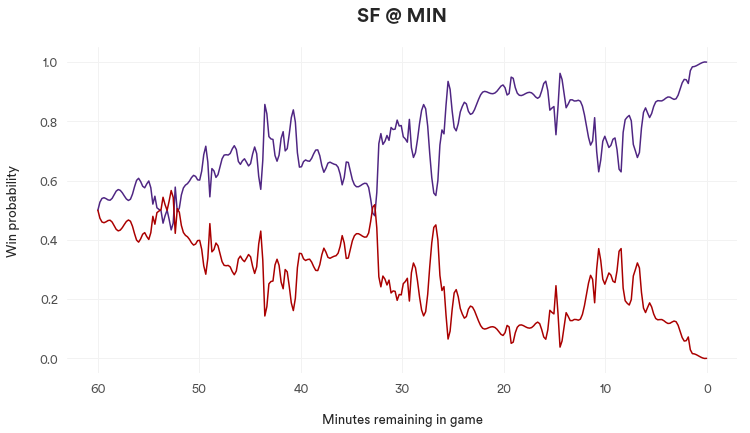

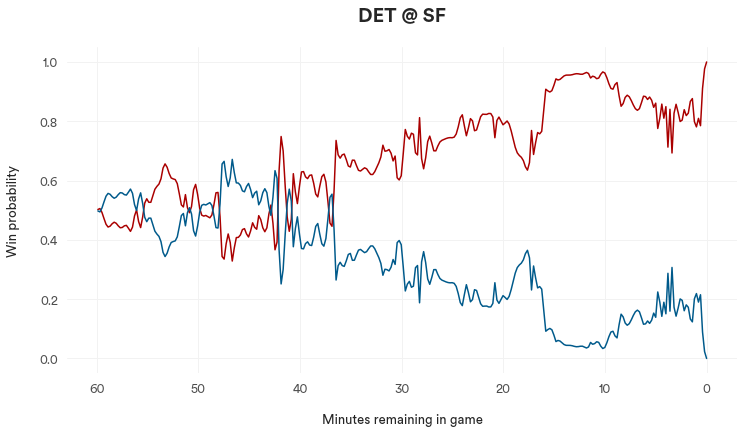

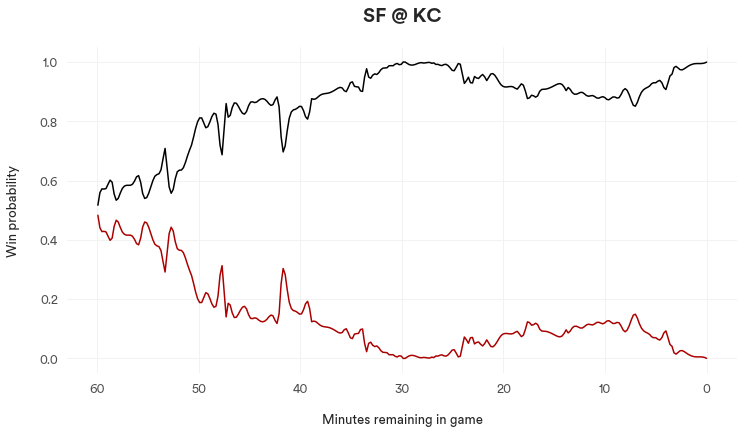

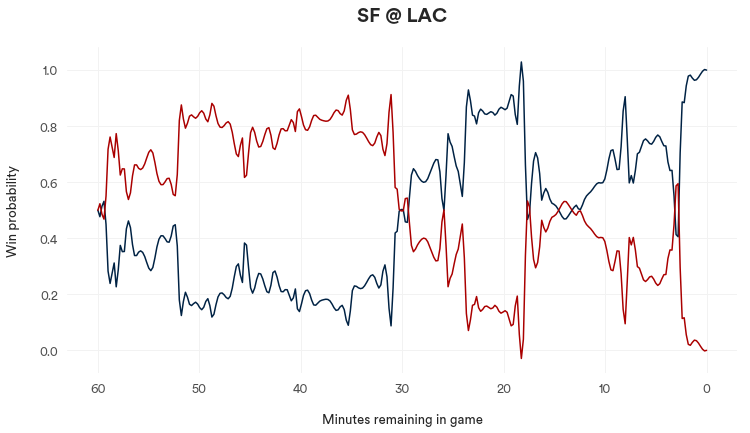

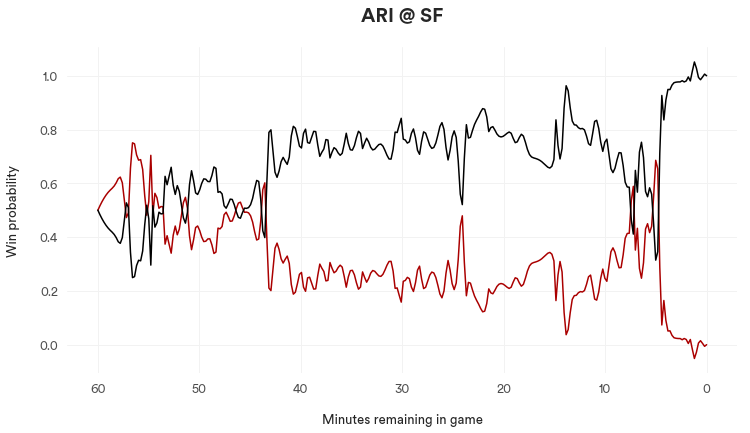

...

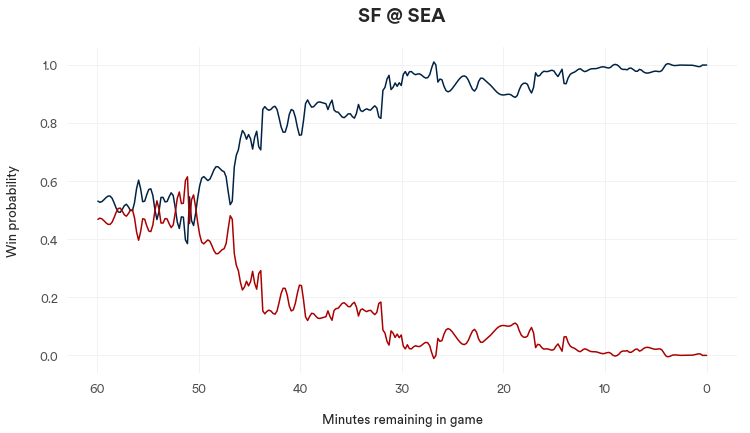

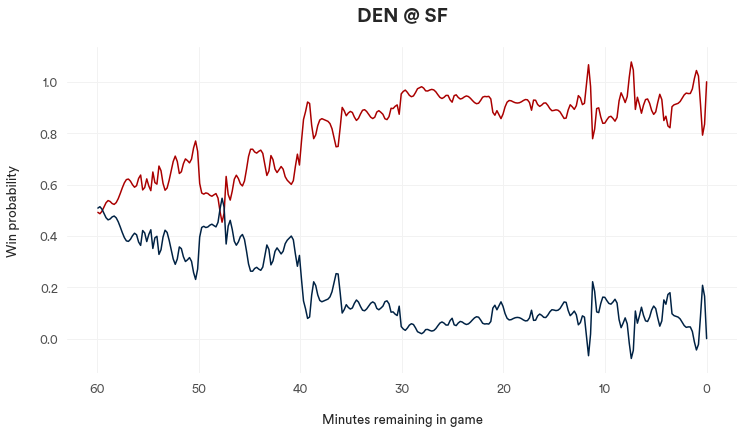

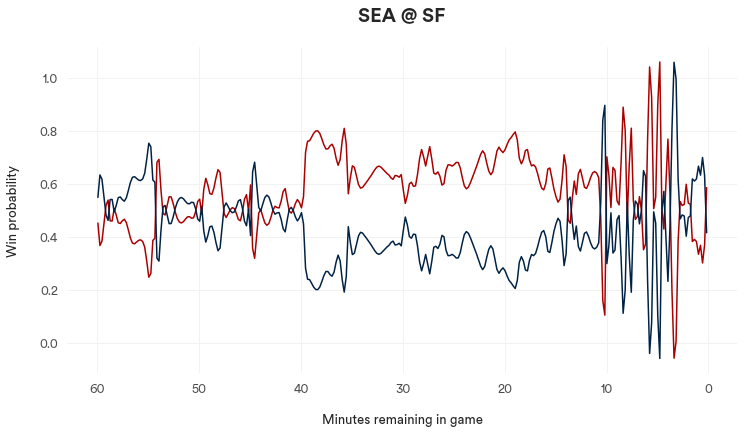

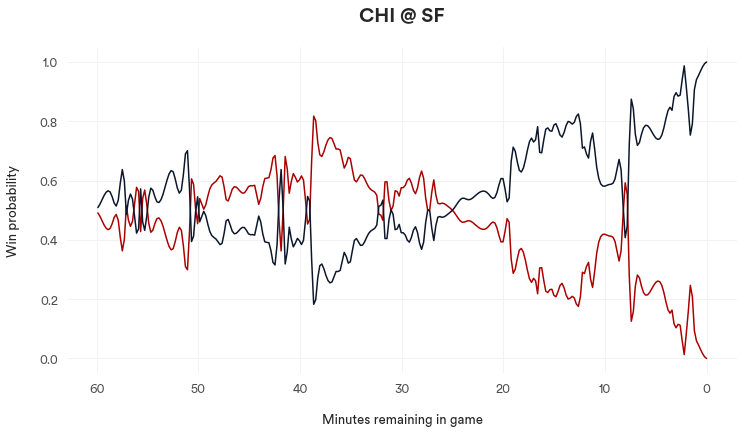

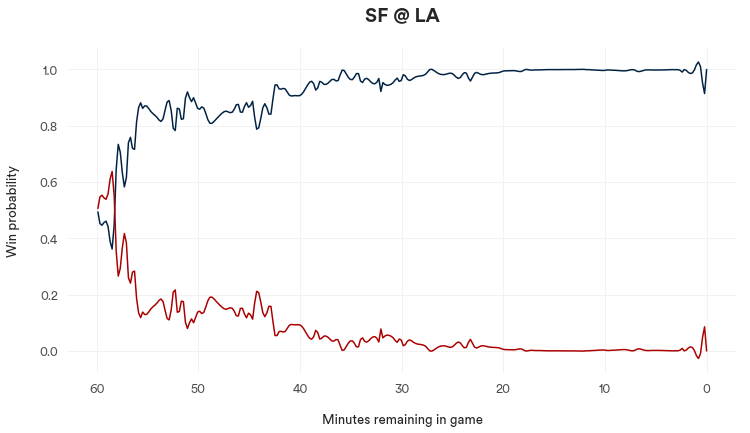

In [195]:

# Looping through SFs game IDs, pulling home team and away team to use as column names and pull correct team colors

for g, game in enumerate(game_ids):
    
    home_team, away_team = sf_schedule[sf_schedule['game_id'] == game][['home_team', 'away_team']].values[0]
    
    win_probs = (df[df['game_id'] == game][['away_wp', 'home_wp', 'game_seconds_remaining']]
                 .rename(columns={'home_wp': home_team, 'away_wp': away_team, 'game_seconds_remaining': 'game_minutes_remaining'}))
    
    win_probs['game_minutes_remaining'] = 60 - (win_probs['game_minutes_remaining']/60)
    win_probs = win_probs.dropna().drop_duplicates(subset ="game_minutes_remaining", keep ='first').sort_values('game_minutes_remaining')
    
    #win_probs = win_probs.set_index('game_minutes_remaining')
    
    #300 represents number of points to make between T.min and T.max
    xnew = np.linspace(win_probs['game_minutes_remaining'].min(),win_probs['game_minutes_remaining'].max(),300) 
    
    spl_home = make_interp_spline(win_probs['game_minutes_remaining'].values, win_probs[home_team].values, k=3)
    spl_away = make_interp_spline(win_probs['game_minutes_remaining'].values, win_probs[away_team].values, k=3)
    
    smooth_home = spl_home(xnew)
    smooth_away = spl_away(xnew)
    
    f, ax = plt.subplots(figsize=(12, 6))
    ax = sns.lineplot(x=60-xnew, y=smooth_home, dashes=False, color=team_colors[home_team])
    ax = sns.lineplot(x=60-xnew, y=smooth_away, dashes=False, color=team_colors[away_team])
    
    ax.set_title('{} @ {}\n'.format(away_team, home_team), fontsize=20, weight='bold')
    ax.set_ylabel('Win probability\n', weight='bold')
    ax.set_xlabel('\nMinutes remaining in game', weight='bold')
    
    ax.invert_xaxis()
    
    sns.despine(left=True, right=True, bottom=True, top=True)
    
    filename = str(away_team + '_at_' + home_team)
    
    plt.savefig('output/smooth/' + filename + '.png', format='png', dpi=300)
    
    

### Mirror charts

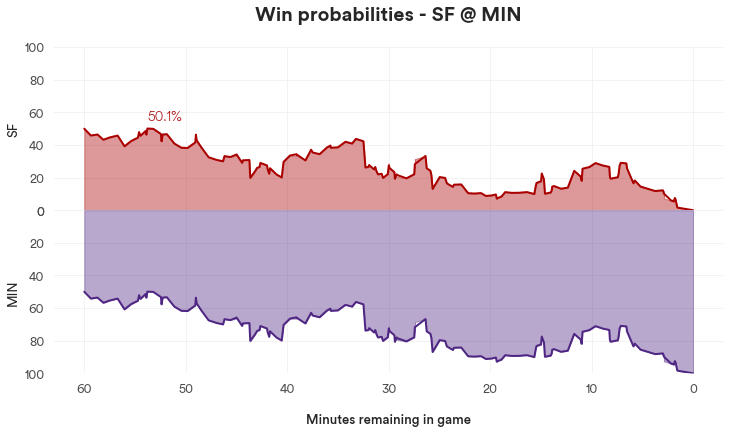

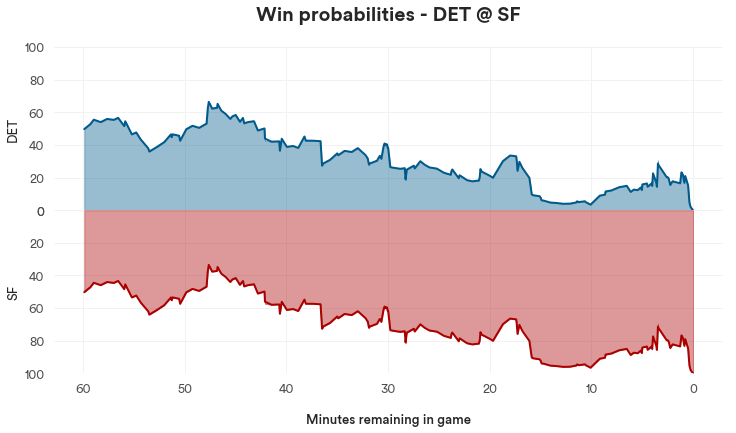

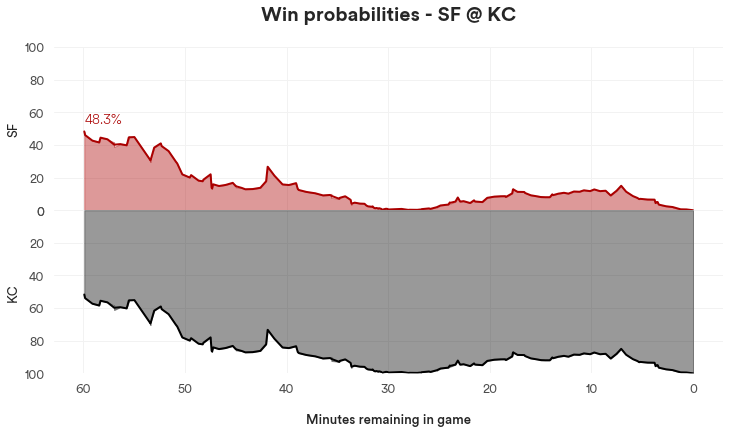

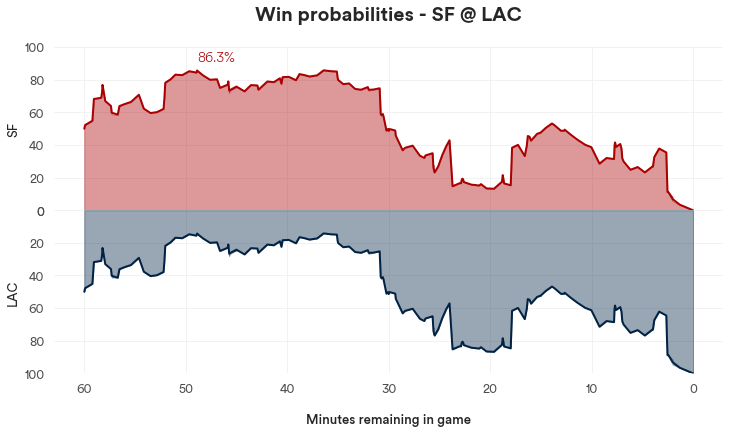

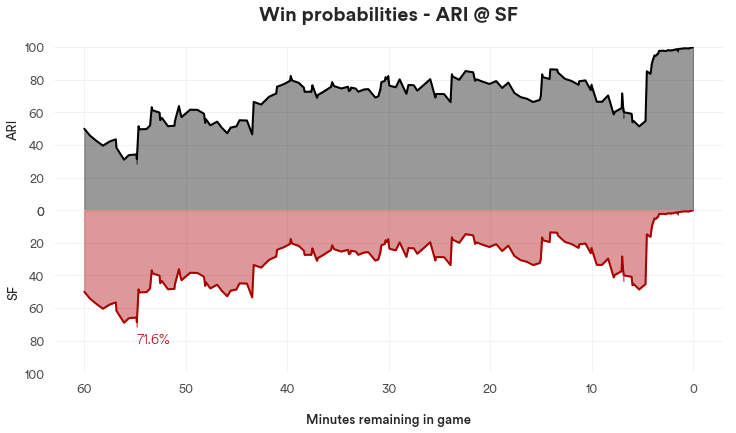

...

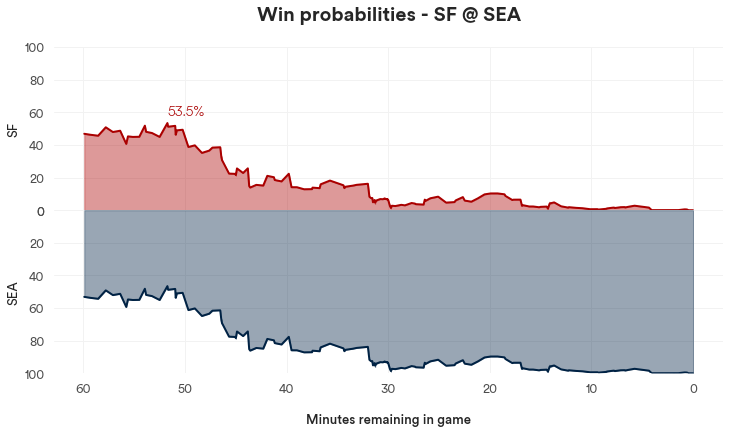

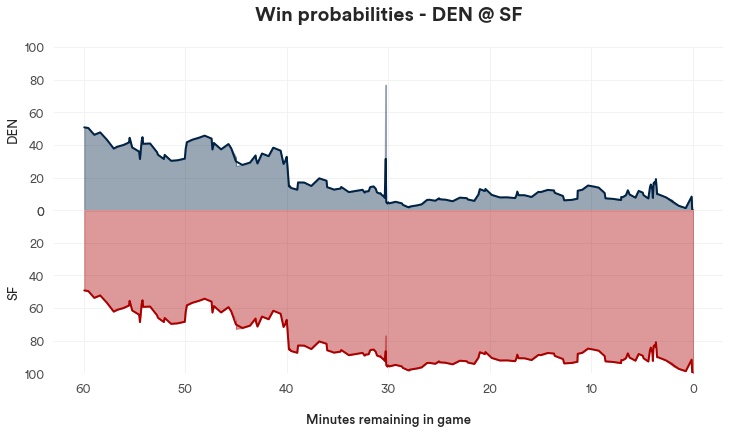

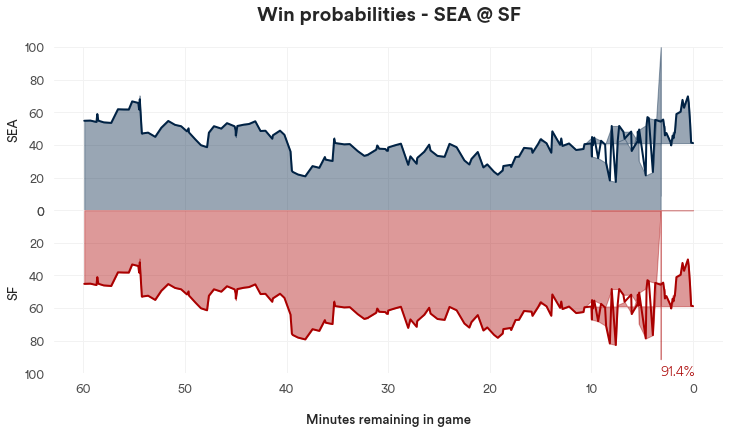

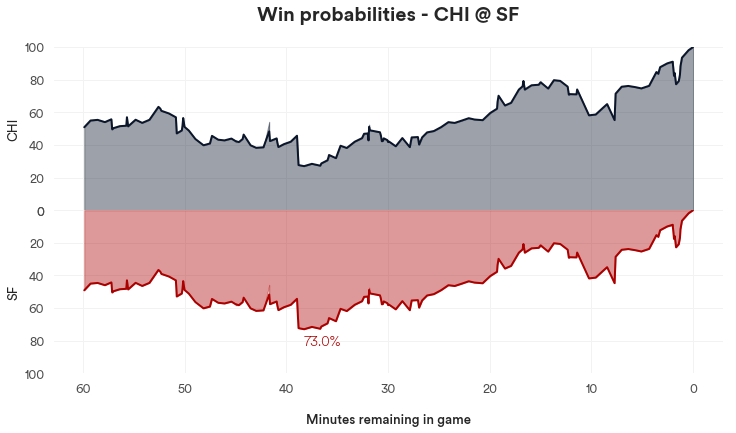

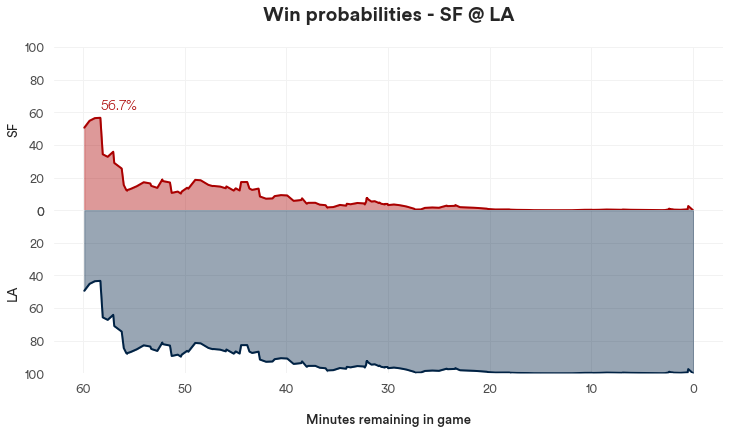

In [289]:
# Looping through SFs game IDs, pulling home team and away team to use as column names and pull correct team colors

game_ids = list(sf_schedule['game_id'])


for g, game in enumerate(game_ids):
    
    home_team, away_team = sf_schedule[sf_schedule['game_id'] == game][['home_team', 'away_team']].values[0]
    
    win_probs = (df[df['game_id'] == game][['away_wp', 'home_wp', 'game_seconds_remaining']]
                 .rename(columns={'home_wp': home_team, 'away_wp': away_team, 'game_seconds_remaining': 'game_minutes_remaining'})
                 )
    
    win_probs[home_team] =  win_probs[home_team].interpolate() * 100
    win_probs[away_team] =  win_probs[away_team].interpolate() * 100
    win_probs = win_probs.dropna()
    
    win_probs['game_minutes_remaining'] = win_probs['game_minutes_remaining']/60
    
    #win_probs[home_team] =  win_probs[home_team].astype(int)
    #win_probs[away_team] =  win_probs[away_team].astype(int)
    
    sf_max = win_probs['SF'].max()
    max_time = win_probs[win_probs['SF'] == sf_max]['game_minutes_remaining'].min()
    
    f, ax = plt.subplots(figsize=(12, 6))
    plt.subplots_adjust(hspace = 0)
    
    #ax.set_title('{} @ {}\n'.format(away_team, home_team), fontsize=20, weight='bold')
    #ax.set_ylabel('Win probability\n')
    #ax.set_xlabel('\nMinutes remaining in game')
    
    #Draw home team
    
    plt.subplot(2, 1, 1)
    
    plt.title('Win probabilities - {} @ {}\n'.format(away_team, home_team), fontsize=20, weight='bold')

    
    
    ax = sns.lineplot(x=win_probs['game_minutes_remaining'], y=win_probs[away_team], color=team_colors[away_team], lw=2)
    
    plt.fill_between(win_probs['game_minutes_remaining'].values, 
                     win_probs[away_team].values, 
                     color=team_colors[away_team], 
                     alpha = 0.4,
                     edgecolor=None
                    )
    
    if away_team == 'SF' and sf_max < 100:
        
        ax.text(max_time,
            sf_max + 5,
            str(round(sf_max, 1)) + '%',
            horizontalalignment='left',
            size='medium',
            color=team_colors['SF'],
            weight='light')
    
    ax.set_ylim((0,100))
    
    ax.invert_xaxis()
    
    plt.subplot(2, 1, 2)
    
    ax = sns.lineplot(x=win_probs['game_minutes_remaining'], y=win_probs[home_team], color=team_colors[home_team], lw=2)

    plt.fill_between(win_probs['game_minutes_remaining'].values, 
                     win_probs[home_team].values, 
                     color=team_colors[home_team], 
                     alpha = 0.4,
                     edgecolor=None
                    )
    
    if home_team == 'SF' and sf_max < 100:
        
        ax.text(max_time,
            sf_max + 10,
            str(round(sf_max, 1)) + '%',
            horizontalalignment='left',
            size='medium',
            color=team_colors['SF'],
            weight='light')

    
    ax.set_ylim((0,100))
    
    ax.invert_xaxis()
    ax.invert_yaxis()
    
    plt.xlabel("\nMinutes remaining in game", weight='medium')
    
    
    sns.despine(left=True, right=True, bottom=True, top=True)
    
    filename = str(away_team + '_at_' + home_team)
    
    plt.savefig('output/sf/' + filename + '.png', format='png', dpi=300)
    
    

## Plotting all win probability charts, why don't ya?

/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


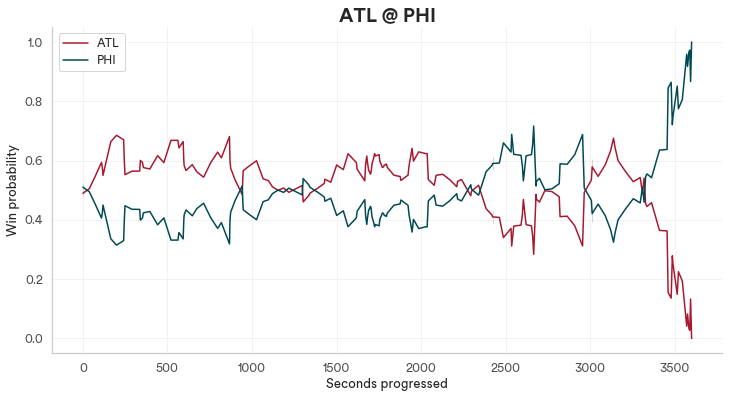

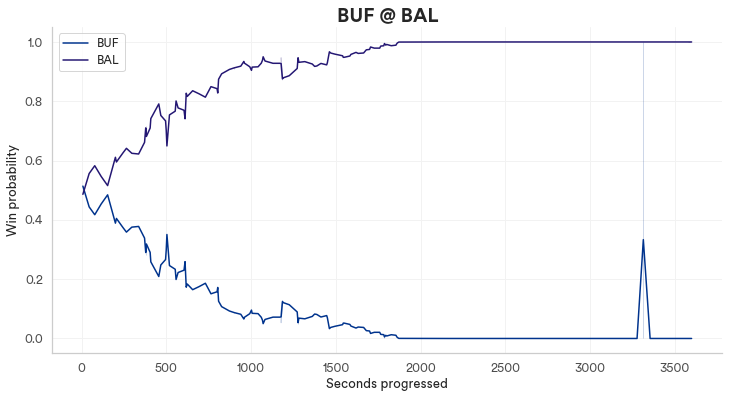

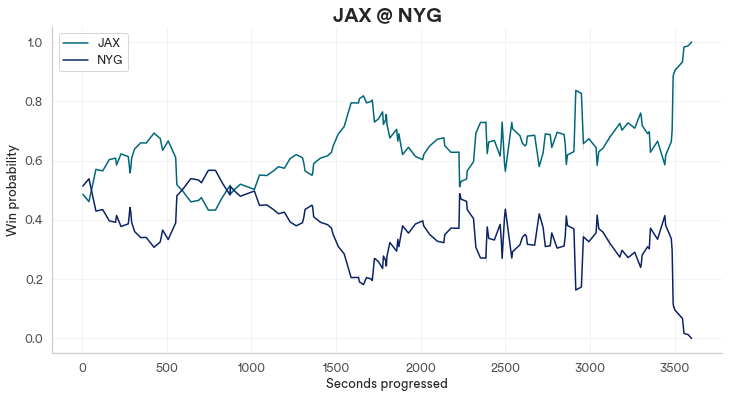

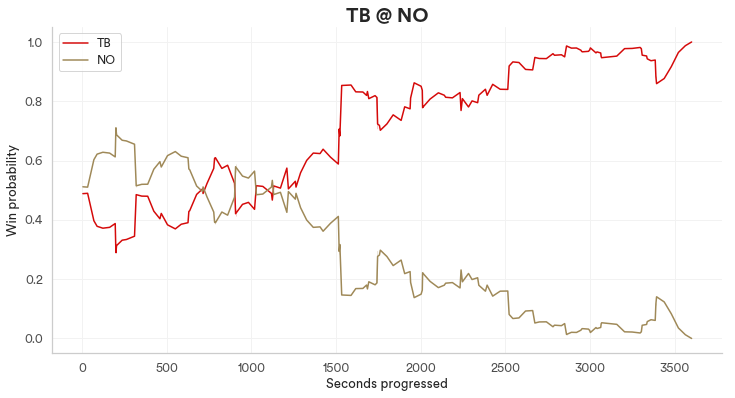

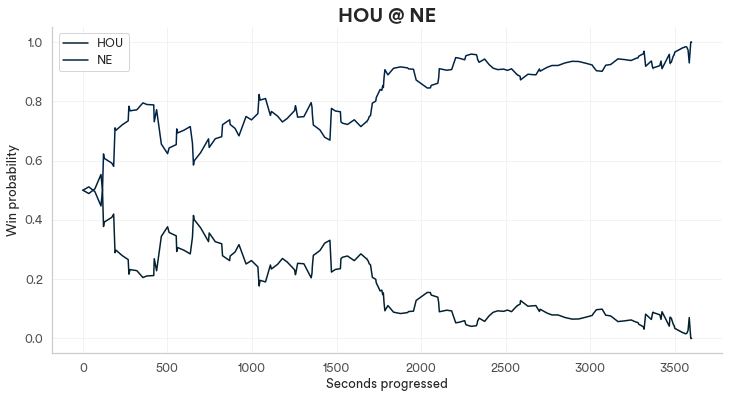

...

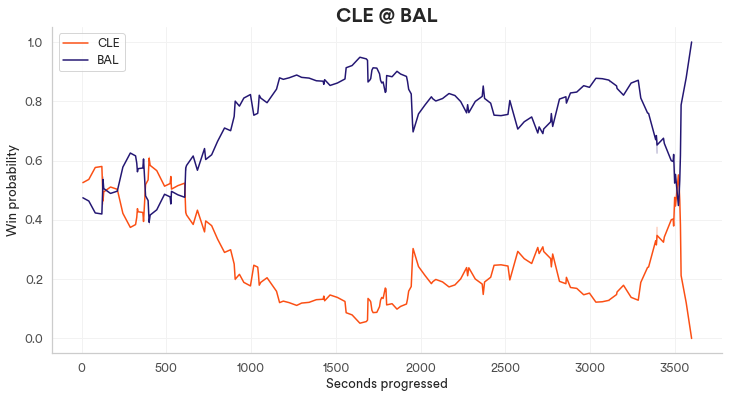

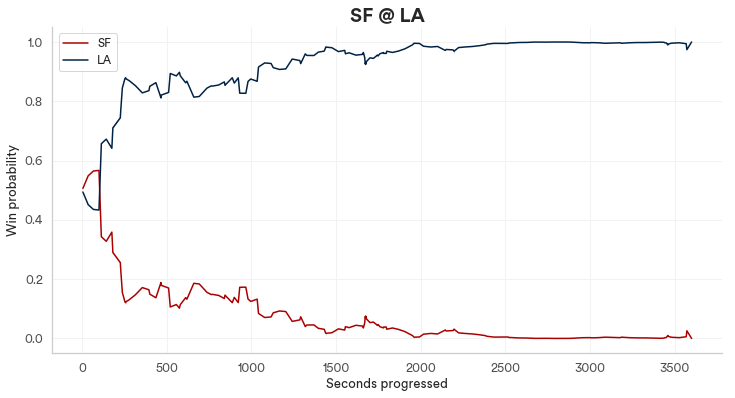

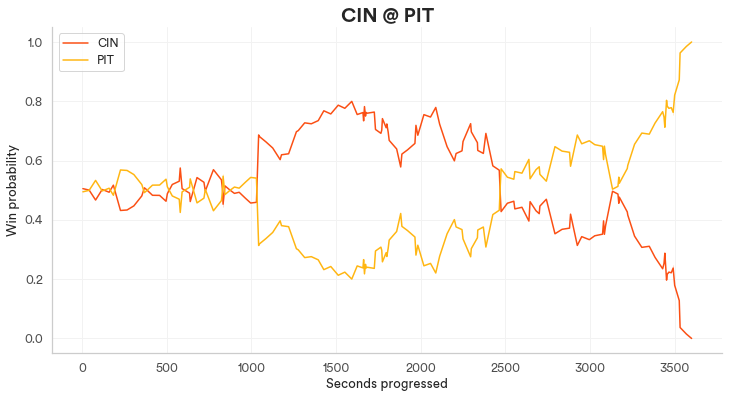

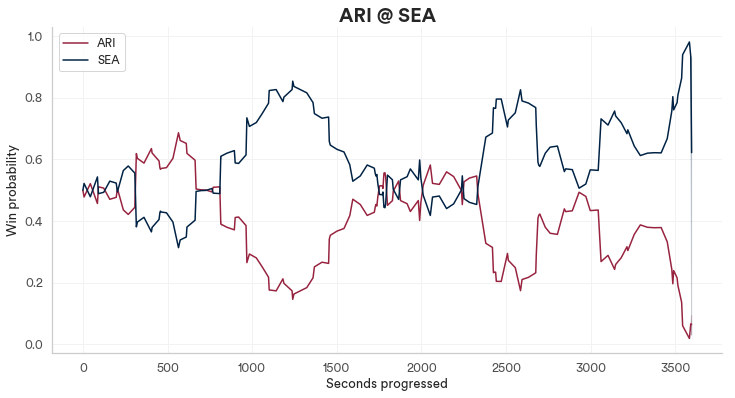

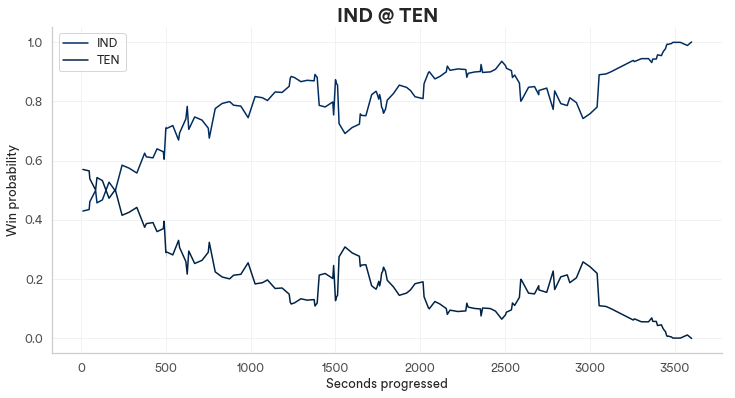

In [266]:
# Looping through SFs game IDs, pulling home team and away team to use as column names and pull correct team colors

game_ids = list(df['game_id'].unique())

for g, game in enumerate(game_ids):
    
    home_team, away_team = df[df['game_id'] == game][['home_team', 'away_team']].values[0]
    
    win_probs = (df[df['game_id'] == game][['away_wp', 'home_wp', 'game_seconds_remaining']]
                 .rename(columns={'game_seconds_remaining': 'seconds_progressed', 'home_wp': home_team, 'away_wp': away_team}))
    
    win_probs['seconds_progressed'] = 3600 - win_probs['seconds_progressed']    
    win_probs = win_probs.set_index('seconds_progressed')
    
    
    f, ax = plt.subplots(figsize=(12, 6))
    ax = sns.lineplot(data=win_probs, dashes=False, palette=team_colors_main)
    
    ax.set_title('{} @ {}'.format(away_team, home_team), fontsize=20, weight='bold')
    ax.set_ylabel('Win probability')
    ax.set_xlabel('Seconds progressed')
    sns.despine()
    
    filename = str(away_team + '_at_' + home_team)
    
    plt.savefig('output/' + filename + '.png', format='png', dpi=300)
    plt.close()
    
    

## Largest drops of WPA

In [8]:
# Getting all game IDs, home and away teams, final score and max WP for both teams

game_results = (
    df.groupby(['game_date', 'game_id', 'away_team', 'home_team'])
        [['total_away_score','total_home_score', 'home_wp', 'away_wp', 'qtr']]
        .max()
        .reset_index()
        .sort_values('game_date')
)

# Setting boolean variables for winner and loser
game_results['home_win'] = game_results['total_home_score'] > game_results['total_away_score']
game_results['away_win'] = game_results['total_home_score'] < game_results['total_away_score']
game_results['draw'] = game_results['total_home_score'] == game_results['total_away_score']
game_results['overtime'] = game_results['qtr'] == 5

game_results = game_results.rename(columns={'home_wp': 'max_home_wp', 'away_wp': 'max_away_wp'})

# Finding the biggest WP for the losing team, and extracting name of losing team
game_results.loc[game_results['home_win'] == False, 'max_loser_wp'] = game_results.loc[game_results['home_win'] == False]['max_home_wp']
game_results.loc[game_results['away_win'] == False, 'max_loser_wp'] = game_results.loc[game_results['away_win'] == False]['max_away_wp']
game_results.loc[game_results['away_win'] == False, 'loser'] = game_results.loc[game_results['away_win'] == False, 'away_team']
game_results.loc[game_results['home_win'] == False, 'loser'] = game_results.loc[game_results['home_win'] == False, 'away_team']

game_results[game_results['overtime'] == False].sort_values('max_loser_wp', ascending=False).head(10)

,game_date,game_id,away_team,home_team,total_away_score,total_home_score,max_home_wp,max_away_wp,qtr,home_win,away_win,draw,overtime,max_loser_wp,loser
1,2018-09-09,2018090900,BUF,BAL,3,47,1.000000,0.999985,4,True,False,False,False,0.999985,BUF
77,2018-10-08,2018100800,WAS,NO,19,43,1.000000,0.997732,4,True,False,False,False,0.997732,WAS
199,2018-12-09,2018120906,NE,MIA,33,34,0.606018,0.985421,4,True,False,False,False,0.985421,NE
39,2018-09-23,2018092306,OAK,MIA,20,28,1.000000,0.974519,4,True,False,False,False,0.974519,OAK
208,2018-12-13,2018121300,LAC,KC,29,28,0.972796,1.000000,4,False,True,False,False,0.972796,LAC
17,2018-09-16,2018091600,CAR,ATL,24,31,1.000000,0.972223,4,True,False,False,False,0.972223,CAR
49,2018-09-30,2018093000,CIN,ATL,37,36,0.971040,1.000000,4,False,True,False,False,0.971040,CIN
13,2018-09-09,2018090912,CHI,GB,22,24,0.908247,0.966889,4,True,False,False,False,0.966889,CHI
234,2018-12-23,2018122310,HOU,PHI,30,32,0.965868,0.965059,4,True,False,False,False,0.965059,HOU
185,2018-12-02,2018120208,LAC,PIT,31,30,0.950453,0.930860,4,False,True,False,False,0.950453,LAC


In [473]:
(game_results[(game_results['overtime'] == False) & (game_results['max_loser_wp'] > 0.65)]
 .groupby('loser')
 .count()['game_id']
 .reset_index()
 .sort_values('game_id', ascending=False)
 .reset_index(drop=True))



,loser,game_id
0,PIT,7
1,ARI,6
2,DEN,6
3,SEA,5
4,CAR,5
5,CIN,5
6,NYG,5
7,NO,5
8,LAC,5
9,IND,4


## Quarter-by-quarter EPA

In [102]:
all_quarters = df.loc[:,['posteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']

sf_quarters = all_quarters[all_quarters['posteam'] == 'SF']
no_quarters = all_quarters[all_quarters['posteam'] == 'NO']


sfno_quarters = pd.concat([sf_quarters, no_quarters])

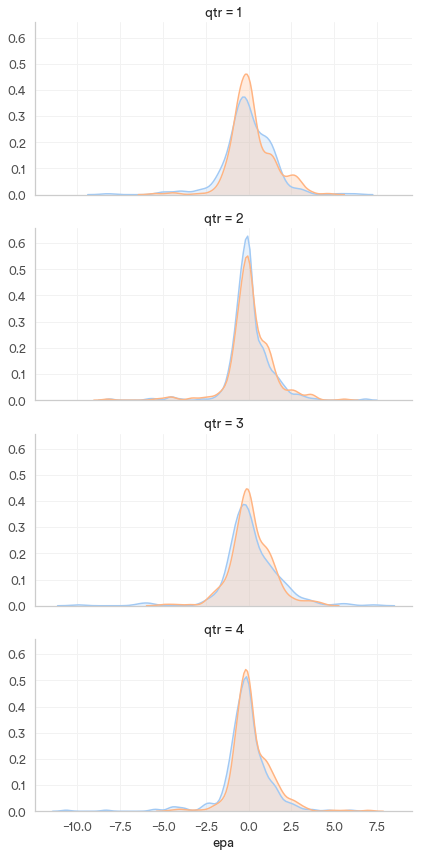

In [10]:
grid = sns.FacetGrid(sfno_quarters[sfno_quarters['qtr'] < 5], row="qtr", hue="posteam", palette="pastel", height=3, aspect=2)

grid.map(sns.kdeplot, 'epa', shade=True)

/anaconda3/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:448: RuntimeWarning: invalid value encountered in greater
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.
/anaconda3/lib/python3.6/site-packages/statsmodels/nonparametric/kde.py:448: RuntimeWarning: invalid value encountered in less
  X = X[np.logical_and(X > clip[0], X < clip[1])] # won't work for two columns.


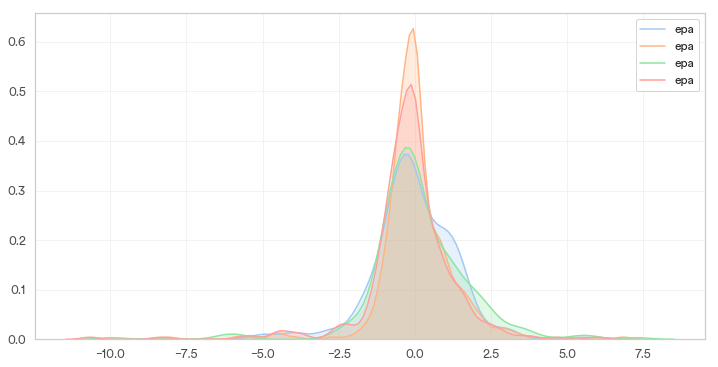

In [340]:
f, ax = plt.subplots(figsize=(12, 6))
ax = sns.kdeplot(sf_quarters[sf_quarters['qtr'] == 1]['epa'], shade=True)
ax = sns.kdeplot(sf_quarters[sf_quarters['qtr'] == 2]['epa'], shade=True)
ax = sns.kdeplot(sf_quarters[sf_quarters['qtr'] == 3]['epa'], shade=True)
ax = sns.kdeplot(sf_quarters[sf_quarters['qtr'] == 4]['epa'], shade=True)

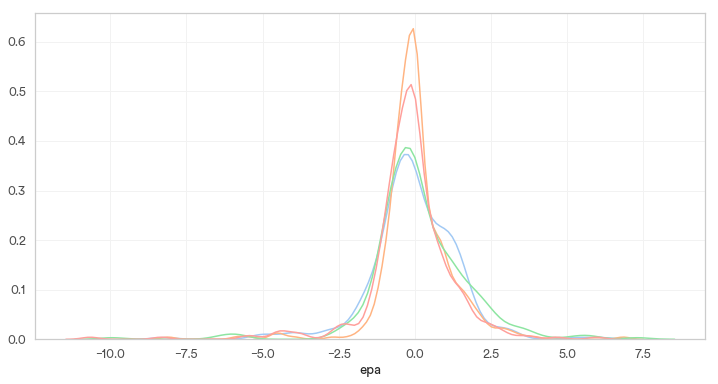

In [341]:
f, ax = plt.subplots(figsize=(12, 6))
ax = sns.distplot(sf_quarters[sf_quarters['qtr'] == 1]['epa'].dropna(), hist=False)
ax = sns.distplot(sf_quarters[sf_quarters['qtr'] == 2]['epa'].dropna(), hist=False)
ax = sns.distplot(sf_quarters[sf_quarters['qtr'] == 3]['epa'].dropna(), hist=False)
ax = sns.distplot(sf_quarters[sf_quarters['qtr'] == 4]['epa'].dropna(), hist=False)

## Quarter-by-quarter WPA

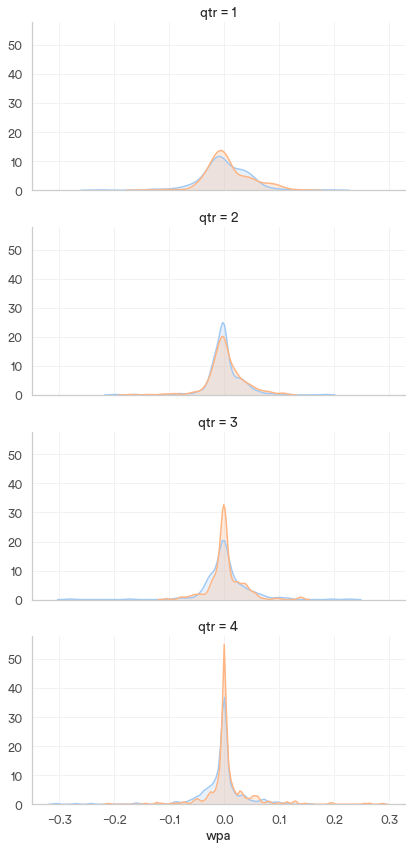

In [342]:
grid = sns.FacetGrid(sfno_quarters[sfno_quarters['qtr'] < 5], row="qtr", hue="posteam", palette="pastel", height=3, aspect=2)

grid.map(sns.kdeplot, 'wpa', shade=True)

## 4th quarter EPA against WPA

In [479]:
sf_quarters = sf_quarters.dropna()
no_quarters = no_quarters.dropna()

sf_quarter_1 = sf_quarters[sf_quarters.qtr == 1]
sf_quarter_2 = sf_quarters[sf_quarters.qtr == 2]
sf_quarter_3 = sf_quarters[sf_quarters.qtr == 3]
sf_quarter_4 = sf_quarters[sf_quarters.qtr == 4]

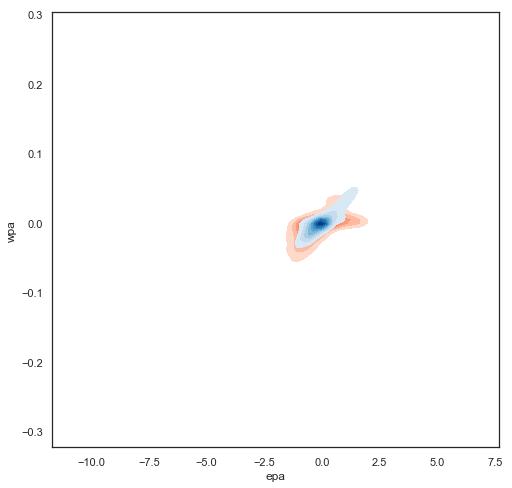

In [482]:
f, ax = plt.subplots(figsize=(8, 8))
ax = sns.kdeplot(sf_quarters[sf_quarters.qtr == 4]['epa'], sf_quarters[sf_quarters.qtr == 4]['wpa'], cmap="Reds", shade=True, shade_lowest=False)
ax = sns.kdeplot(no_quarters['epa'], no_quarters['wpa'], cmap="Blues", shade=True, shade_lowest=False)
                                                          

That's kind of disappointing. Too much overlap.

## League-wide mean EPA for the final 5 minutes

In [345]:
team_order = (all_quarters[all_quarters['game_seconds_remaining'] <= 300]
              .groupby('posteam')['epa']
              .mean()
              .reset_index()
              .sort_values('epa', ascending=False)['posteam'])
team_order

21     NO
22    NYG
27    SEA
12    HOU
25    PHI
1     ATL
15     KC
29     TB
30    TEN
26    PIT
9     DEN
16     LA
6     CIN
7     CLE
13    IND
20     NE
11     GB
4     CAR
24    OAK
19    MIN
10    DET
2     BAL
5     CHI
8     DAL
18    MIA
0     ARI
17    LAC
14    JAX
31    WAS
3     BUF
23    NYJ
28     SF
Name: posteam, dtype: object

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


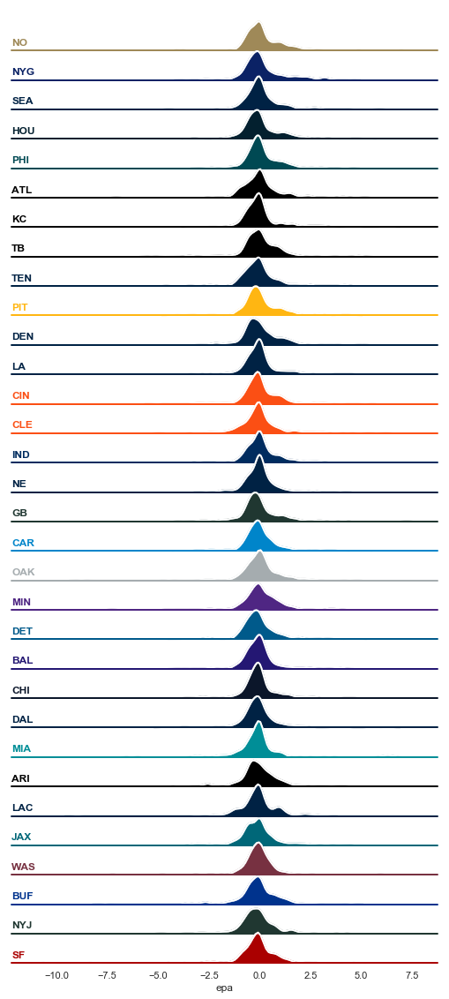

In [467]:
sns.set(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Create the data
#rs = np.random.RandomState(1979)
#x = rs.randn(500)
#g = np.tile(list("ABCDEFGHIJ"), 50)
#df_2 = pd.DataFrame(dict(x=x, g=g))
#m = df_2.g.map(ord)
#df_2["x"] += m

data = all_quarters[all_quarters['game_seconds_remaining'] <= 300]
data['posteam'] = data['posteam'].astype("category")
data['posteam'].cat.set_categories(team_order, inplace=True)

data = data.sort_values('posteam')

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(data, row="posteam", hue="posteam", aspect=15, height=.5, palette=team_colors)

# Draw the densities in a few steps
g.map(sns.kdeplot, "epa", clip_on=False, shade=True, alpha=1, lw=1.5, bw=.2)
g.map(sns.kdeplot, "epa", clip_on=False, color="w", lw=2, bw=.2)
g.map(plt.axhline, y=0, lw=2, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "epa")

# Set the subplots to overlap
g.fig.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[])
g.despine(bottom=True, left=True)

In [347]:
last_five_min = (all_quarters[all_quarters['game_seconds_remaining'] <= 300]
              .groupby('posteam')['epa']
              .mean()
              .reset_index()
              .sort_values('epa', ascending=False))
last_five_min

,posteam,epa
21,NO,0.207079
22,NYG,0.197898
27,SEA,0.171991
12,HOU,0.144221
25,PHI,0.119882
1,ATL,0.106397
15,KC,0.097954
29,TB,0.041500
30,TEN,0.035420
26,PIT,0.035346


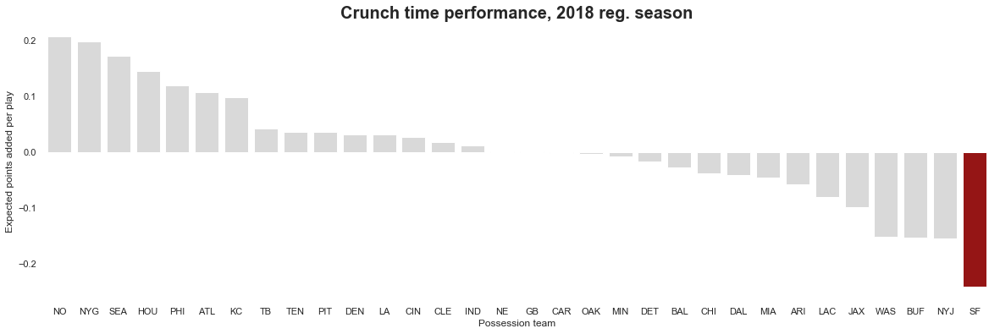

In [348]:
f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=last_five_min, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('Possession team')
ax.set_title('Crunch time performance, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

In [284]:
fourth_quarter_epa = all_quarters[all_quarters['qtr'] == 4].groupby('posteam')['epa'].mean().reset_index().sort_values('epa', ascending=False)
third_quarter_epa = all_quarters[all_quarters['qtr'] == 3].groupby('posteam')['epa'].mean().reset_index().sort_values('epa', ascending=False)
second_quarter_epa = all_quarters[all_quarters['qtr'] == 2].groupby('posteam')['epa'].mean().reset_index().sort_values('epa', ascending=False)
first_quarter_epa = all_quarters[all_quarters['qtr'] == 1].groupby('posteam')['epa'].mean().reset_index().sort_values('epa', ascending=False)

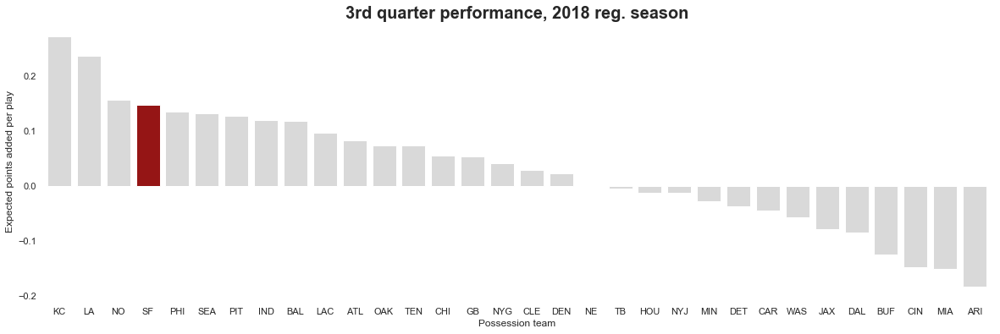

In [350]:
f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=third_quarter_epa, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('Possession team')
ax.set_title('3rd quarter performance, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

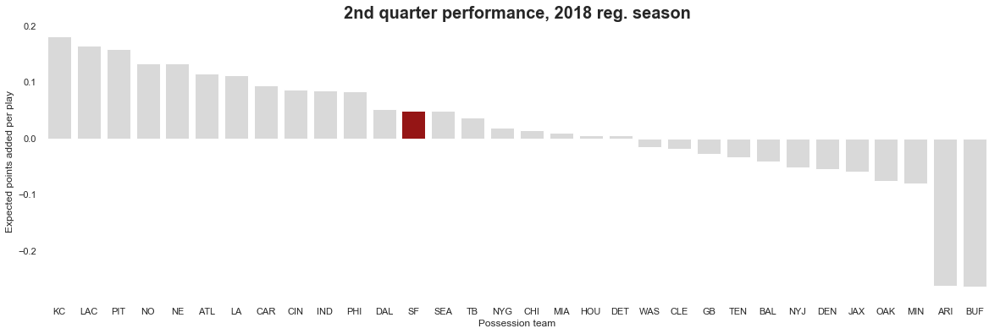

In [351]:
f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=second_quarter_epa, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('Possession team')
ax.set_title('2nd quarter performance, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

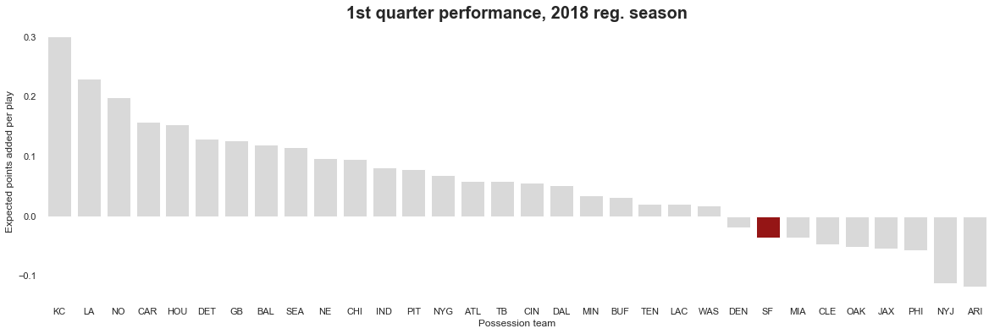

In [352]:
f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=first_quarter_epa, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('Possession team')
ax.set_title('1st quarter performance, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

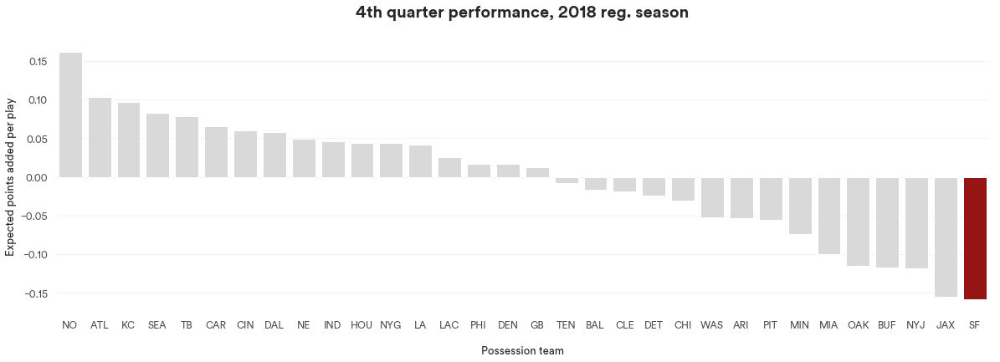

In [285]:
f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=fourth_quarter_epa, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('\nPossession team')
ax.set_title('4th quarter performance, 2018 reg. season\n', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

plt.savefig('output/epa/' + '4th_quarter_epa_barchart' + '.png', format='png', dpi=300)

In [296]:
export = fourth_quarter_epa.reset_index(drop=True).rename(columns={'posteam': 'Team', 'epa': 'EPA per play'})
export['Rank'] = export.index + 1
export.to_csv('output/epa/4th_quarter_epa_table.csv')

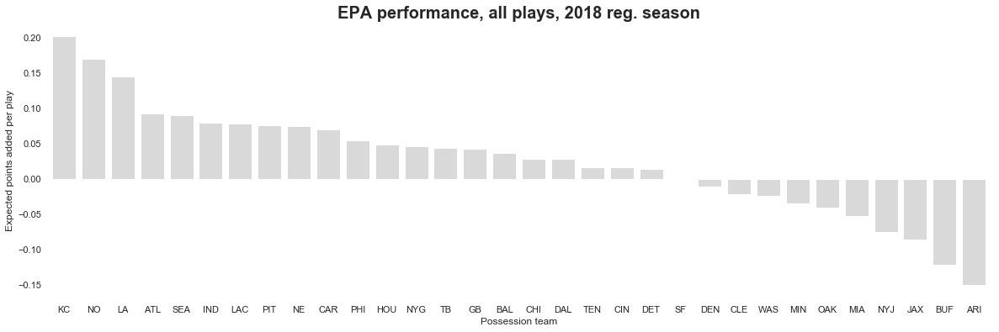

In [354]:
all_quarters_epa = all_quarters.groupby('posteam')['epa'].mean().reset_index().sort_values('epa', ascending=False)

f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="epa", data=all_quarters_epa, palette=team_colors_gray)

ax.set_ylabel('Expected points added per play')
ax.set_xlabel('Possession team')
ax.set_title('EPA performance, all plays, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

## EPA per quarter in one plot

In [11]:
all_quarters = df.loc[:,['posteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']

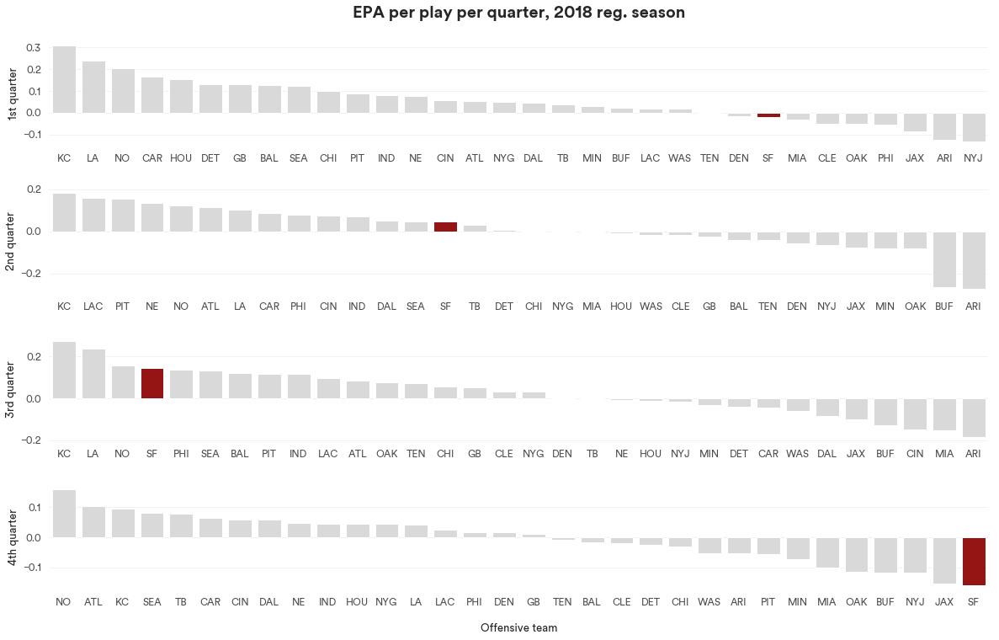

In [299]:
f, ax = plt.subplots(figsize=(20, 12))

plt.subplots_adjust(hspace = .4)

for i in range(1,5):
    
    data = (all_quarters[all_quarters['qtr'] == i]
                .groupby('posteam')['epa']
                .mean()
                .reset_index()
                .sort_values('epa', ascending=False))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    plt.subplot(4, 1, i)
    
    sns.barplot(x="posteam", y="epa", data=data, palette=team_colors_gray)

    #ax.set_ylabel('Total points scored')
    #ax.set_xlabel('Possession team')
    plt.ylabel("{} quarter".format(quarter))
    plt.xlabel("")
    
    if i == 1:
        plt.title('EPA per play per quarter, 2018 reg. season\n'.format(quarter), fontsize=20, weight='bold')
    
    if i == 4:
        plt.xlabel("\nOffensive team")
    
    

    sns.despine(top=True, bottom=True, left=True, right=True)
    plt.savefig('output/epa/' + 'all_quarters_epa_barchart' + '.png', format='png', dpi=300)
    

## EPA line charts

In [117]:
all_quarters = df.loc[:,['posteam', 'defteam','qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']
#bins = [0, 1, 5, 10, 25, 50, 100]
#labels = [1,2,3,4,5,6]
#df['binned'] = pd.cut(df['percentage'], bins=bins, labels=labels)

bins = list(range(3600,-300,-300))
labels = list(range(55, -5, -5))

bins.reverse()
labels.reverse()
all_quarters['bins'] = pd.cut(all_quarters['game_seconds_remaining'], bins=bins, labels=labels)

In [107]:
data_line = (all_quarters[all_quarters['qtr'] < 5].groupby(['posteam', 'qtr', 'bins'])['epa']
                .mean()
                .reset_index()
                )

data_line['rank'] = data_line.groupby(['qtr', 'bins'])['epa'].rank(ascending=False)

In [68]:
data_bar = (all_quarters[all_quarters['qtr'] < 5].groupby(['posteam', 'qtr', 'bins'])['epa']
                .count()
                .reset_index()
                )

data_bar = data_bar.rename(columns={'epa': 'play_count'})

data_bar.head()

,posteam,qtr,bins,play_count
0,ARI,1,45,90
1,ARI,1,50,106
2,ARI,1,55,79
3,ARI,2,30,145
4,ARI,2,35,83


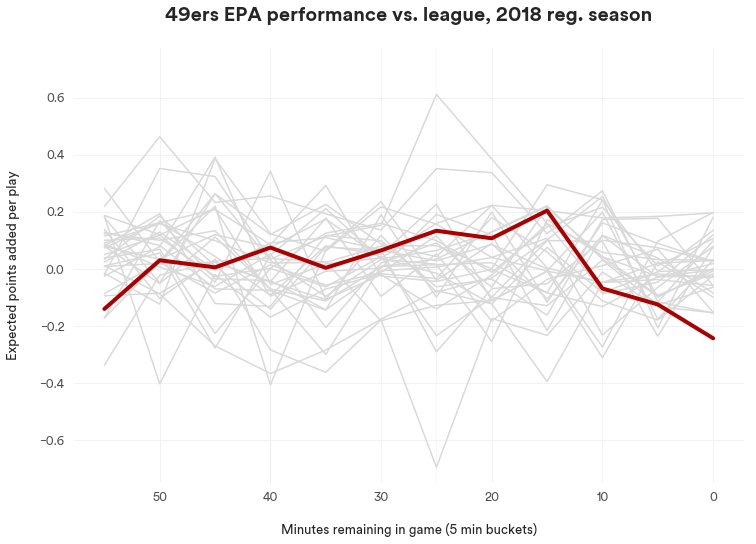

In [111]:
#fig, (ax_line, ax_bar) = plt.subplots(nrows=2, ncols=1, figsize=(12, 8), gridspec_kw = {'height_ratios':[3, 1]})
#f, (a0, a1) = plt.subplots(1,2, gridspec_kw = {'width_ratios':[3, 1]})
#fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(12,5))

f, ax = plt.subplots(figsize=(12, 8))

sns.lineplot(x="bins", 
             y="epa", 
             hue="posteam", 
             palette=team_colors_gray, 
             data=data_line[data_line['posteam'] != 'SF'],
             legend=False,
             #ax=ax_line
            )

sns.lineplot(x="bins", 
             y="epa", 
             hue="posteam", 
             palette=team_colors_gray, 
             data=data_line[data_line['posteam'] == 'SF'],
             legend=False,
             linewidth=4,
             #ax=ax_line
                 )


ax.invert_yaxis()
ax.set_ylim((-.75,.775))
ax.invert_xaxis()

ax.set_ylabel('Expected points added per play\n')

ax.set_title('49ers EPA performance vs. league, 2018 reg. season\n', fontsize=20, weight='bold')

sns.despine(left=True, right=True, bottom=True, top=True)

###

#sns.barplot(data=data_bar[data_bar['posteam'] == 'SF'], x='bins', y='play_count', ax=ax_bar)
#ax_bar.invert_xaxis()
ax.set_xlabel('\nMinutes remaining in game (5 min buckets)')

sns.despine(top=True, bottom=True, left=True, right=True)

plt.savefig('output/epa/' + '49ers_epa_linechart' + '.png', format='png', dpi=300)

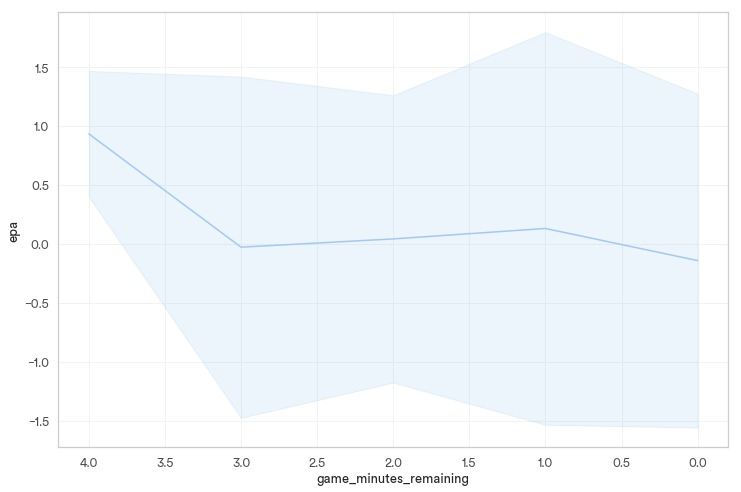

In [266]:
all_quarters['game_minutes_remaining'] = all_quarters['game_seconds_remaining'] / 60 / 15
all_quarters = all_quarters.dropna()
all_quarters['game_minutes_remaining'] = all_quarters['game_minutes_remaining'].astype(int)

f, ax = plt.subplots(figsize=(12, 8))

ax = sns.lineplot(x='game_minutes_remaining',
                  y='epa',
                  data = all_quarters[all_quarters['posteam'] == 'SF'], ci='sd')

ax.invert_xaxis()

In [126]:
heat_data = (all_quarters[all_quarters['qtr'] < 5].groupby(['defteam', 'qtr', 'bins'])['epa']
                .mean()
                .reset_index()
                )

heat_data['rank'] = heat_data.groupby(['qtr', 'bins'])['epa'].rank(ascending=False)
heat_data.sort_values('epa', ascending=True)

,defteam,qtr,bins,epa,rank
299,OAK,2,25,-2.982193,6.0
65,CHI,2,25,-1.382975,5.0
334,SEA,1,40,-0.931115,2.0
258,NE,4,10,-0.444426,32.0
245,MIN,4,5,-0.388033,32.0
68,CHI,2,40,-0.368834,32.0
215,LAC,2,35,-0.367021,32.0
67,CHI,2,35,-0.306954,31.0
44,BUF,3,15,-0.291451,32.0
242,MIN,3,20,-0.285428,32.0


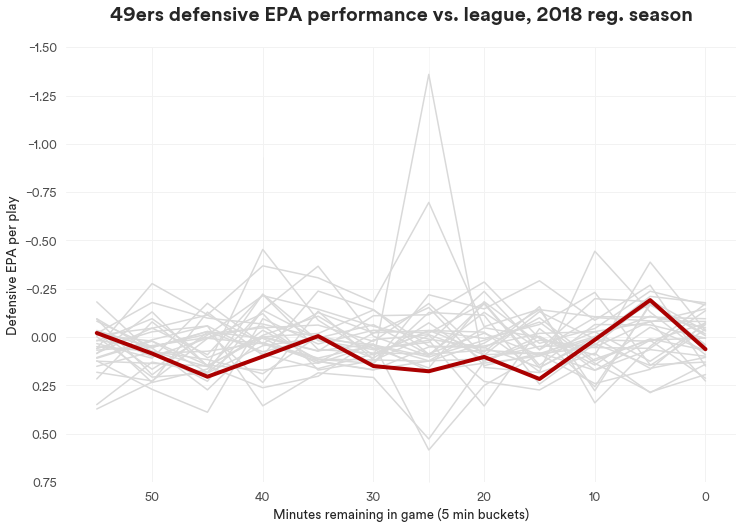

In [128]:
f, ax = plt.subplots(figsize=(12, 8))

ax = sns.lineplot(x="bins", 
                  y="epa", 
                  hue="defteam", 
                  palette=team_colors_gray, 
                  data=heat_data[heat_data['defteam'] != 'SF'],
                 legend=False)

ax = sns.lineplot(x="bins", 
                  y="epa", 
                  hue="defteam", 
                  palette=team_colors_gray, 
                  data=heat_data[heat_data['defteam'] == 'SF'],
                  legend=False,
                  linewidth=4
                 )



ax.invert_xaxis()
ax.set_ylim((-1.5,.75))
ax.invert_yaxis()

ax.set_ylabel('Defensive EPA per play')
ax.set_xlabel('Minutes remaining in game (5 min buckets)')
ax.set_title('49ers defensive EPA performance vs. league, 2018 reg. season\n', fontsize=20, weight='bold')

sns.despine(left=True, right=True, bottom=True, top=True)

In [46]:
heat_data = (all_quarters[all_quarters['qtr'] < 5].groupby(['posteam', 'qtr', 'bins'])['clutch_epa']
                .mean()
                .reset_index()
                )

heat_data['rank'] = heat_data.groupby(['qtr', 'bins'])['clutch_epa'].rank(ascending=False)
heat_data.head()

,posteam,qtr,bins,clutch_epa,rank
0,ARI,1,45,0.061534,5.0
1,ARI,1,50,0.071137,3.0
2,ARI,1,55,0.065912,10.0
3,ARI,2,30,0.018870,30.0
4,ARI,2,35,0.049712,7.0


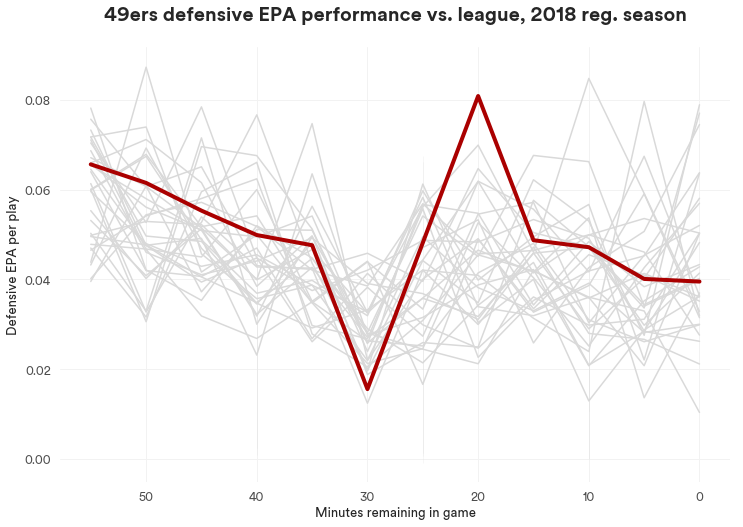

In [48]:
f, ax = plt.subplots(figsize=(12, 8))

ax = sns.lineplot(x="bins", 
                  y="clutch_epa", 
                  hue="posteam", 
                  palette=team_colors_gray, 
                  data=heat_data[heat_data['posteam'] != 'SF'],
                 legend=False)

ax = sns.lineplot(x="bins", 
                  y="clutch_epa", 
                  hue="posteam", 
                  palette=team_colors_gray, 
                  data=heat_data[heat_data['posteam'] == 'SF'],
                  legend=False,
                  linewidth=4
                 )


#ax.invert_yaxis()
ax.invert_xaxis()

ax.set_ylabel('Defensive EPA per play')
ax.set_xlabel('Minutes remaining in game')
ax.set_title('49ers defensive EPA performance vs. league, 2018 reg. season\n', fontsize=20, weight='bold')

sns.despine(left=True, right=True, bottom=True, top=True)

## EPA by pass/run plays per quarter

In [113]:
all_quarters = df.loc[:,['posteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']

sf_quarters = all_quarters[(all_quarters['posteam'] == 'SF') 
                           & (all_quarters['play_type'].isin(['pass', 'run'])) 
                           & (all_quarters['qtr'] < 5)]

all_quarters_rp = all_quarters[ (all_quarters['play_type'].isin(['pass', 'run'])) 
                           & (all_quarters['qtr'] < 5)]



In [356]:
sf_quarters.groupby(['qtr', 'play_type'])['epa'].mean().reset_index()

,qtr,play_type,epa
0,1,pass,-0.145721
1,1,run,-0.061537
2,2,pass,0.208556
3,2,run,-0.201697
4,3,pass,0.255575
5,3,run,0.058472
6,4,pass,-0.182838
7,4,run,-0.202878


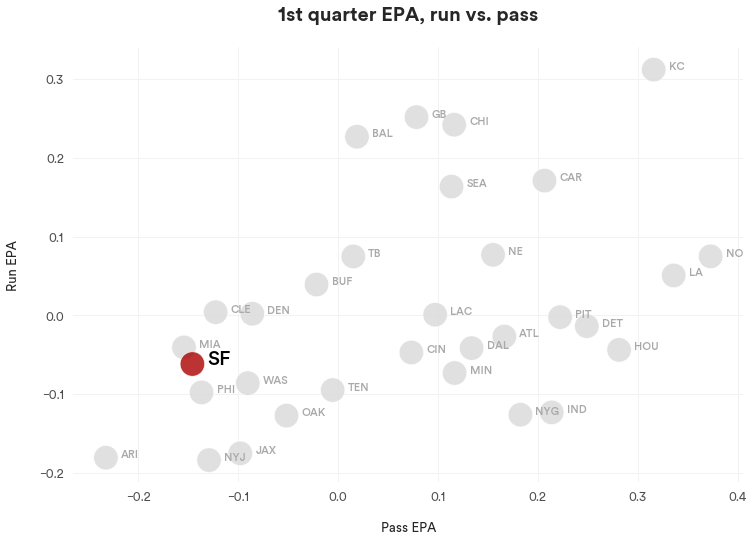

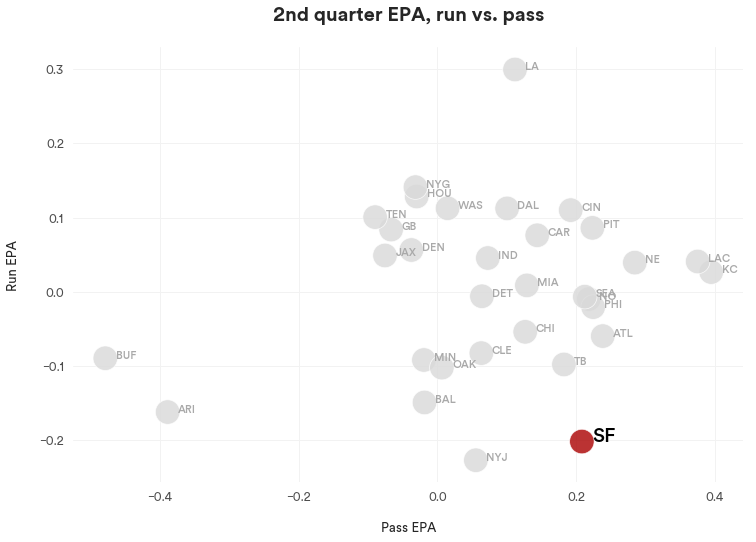

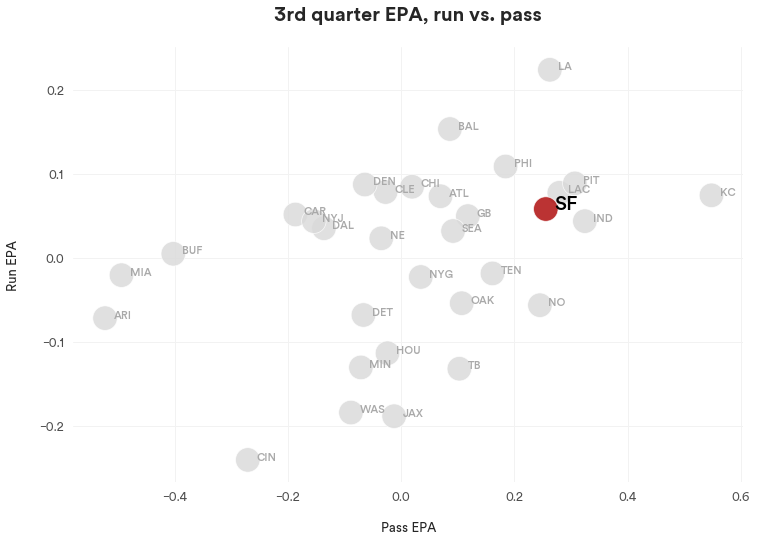

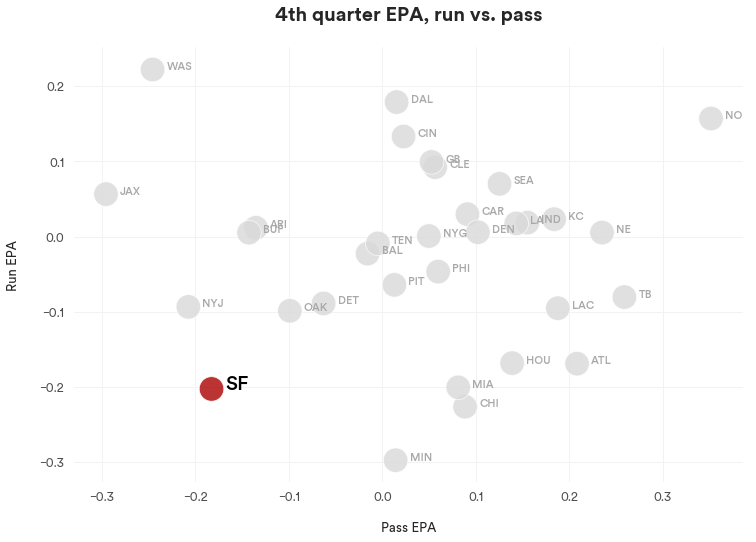

In [268]:
for i in range(1,5):
    
    data = (all_quarters_rp[all_quarters_rp['qtr'] == i]
         .groupby(['posteam', 'qtr', 'play_type'])['epa']
         .mean()
         .reset_index()
         .pivot(index='posteam', columns='play_type', values='epa' )
         .reset_index())
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]

    #sns.regplot(data=data, x="x", y="y", fit_reg=False, marker="+", color="skyblue")
    f, ax = plt.subplots(figsize=(12, 8))

    ax = sns.scatterplot(x="pass", 
                         y="run",
                         hue="posteam", 
                         palette=team_colors_gray,
                         data=data,
                         legend=False,
                         alpha=0.8,
                         s=600
                        )

    ax.set_ylabel('Run EPA\n')
    ax.set_xlabel('\nPass EPA')
    ax.set_title('{} quarter EPA, run vs. pass\n'.format(quarter), fontsize=20, weight='bold')

    others = data[data['posteam'] != 'SF'].reset_index()

    for line in range(0,others.shape[0]):
         ax.text(others['pass'][line]+0.015, others['run'][line], others['posteam'][line], horizontalalignment='left', size='small', color='darkgray', weight='semibold')

    ax.text(data[data['posteam'] == 'SF']['pass']+0.015, data[data['posteam'] == 'SF']['run'], data[data['posteam'] == 'SF']['posteam'].values[0], horizontalalignment='left', size=20, color='black', weight='semibold')
    sns.despine(left=True, right=True, top=True, bottom=True)
    
    plt.savefig('output/epa/' + quarter + '_quarter_epa_scatter' + '.png', format='png', dpi=300)
    

In [456]:
data[data['posteam'] == 'SF']['posteam'].values[0]

'SF'

In [401]:
(all_quarters_rp[all_quarters_rp['qtr'] == 4]
 .groupby(['posteam', 'qtr'])
 .count()
 .reset_index())

,posteam,qtr,epa,wpa,game_seconds_remaining,play_type,clutch_epa,seconds_progressed
0,ARI,4,286,287,290,290,283,290
1,ATL,4,274,275,276,276,273,276
2,BAL,4,247,248,249,249,247,249
3,BUF,4,266,267,268,268,265,268
4,CAR,4,300,303,303,303,300,303
5,CHI,4,230,231,231,231,230,231
6,CIN,4,252,255,257,257,251,257
7,CLE,4,255,253,256,256,252,256
8,DAL,4,278,276,278,278,276,278
9,DEN,4,291,293,294,294,291,294


## Points scored per quarter

In [495]:
all_quarters = df.loc[:,['posteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']

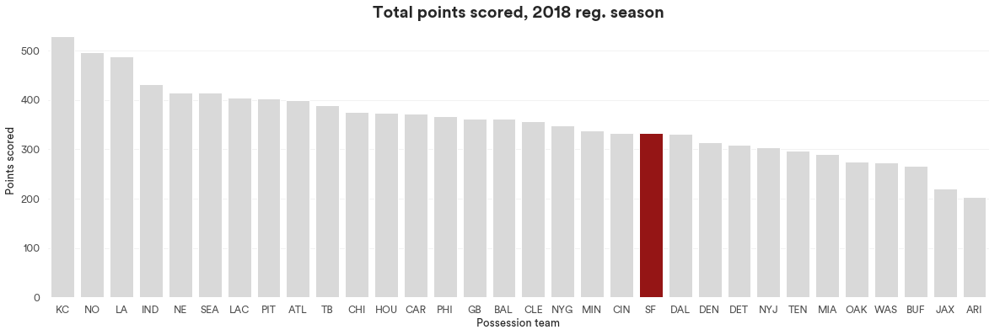

In [496]:
all_quarters_points = all_quarters.groupby('posteam')['points_scored'].sum().reset_index().sort_values('points_scored', ascending=False)

f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="posteam", y="points_scored", data=all_quarters_points, palette=team_colors_gray)

ax.set_ylabel('Points scored')
ax.set_xlabel('Possession team')
ax.set_title('Total points scored, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

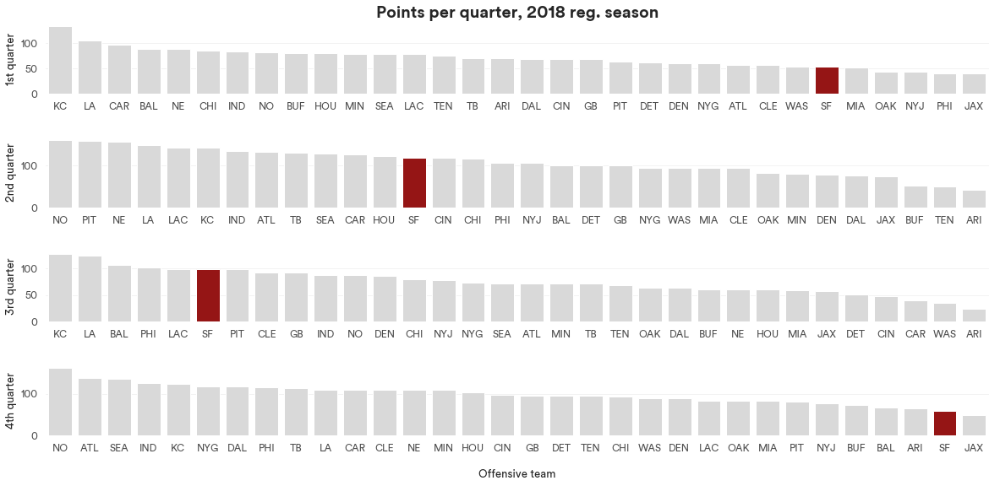

In [528]:
f, ax = plt.subplots(figsize=(20, 9))

plt.subplots_adjust(hspace = .6)

for i in range(1,5):
    
    data = (all_quarters[all_quarters['qtr'] == i]
                .groupby('posteam')['points_scored']
                .sum()
                .reset_index()
                .sort_values('points_scored', ascending=False))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    plt.subplot(4, 1, i)
    
    sns.barplot(x="posteam", y="points_scored", data=data, palette=team_colors_gray)

    #ax.set_ylabel('Total points scored')
    #ax.set_xlabel('Possession team')
    plt.ylabel("{} quarter".format(quarter))
    plt.xlabel("")
    
    if i == 1:
        plt.title('Points per quarter, 2018 reg. season'.format(quarter), fontsize=20, weight='bold')
    
    if i == 4:
        plt.xlabel("\nOffensive team")
    
    

    sns.despine(top=True, bottom=True, left=True, right=True)
    

## Punts forced per quarter

In [363]:
all_quarters = df.loc[:,['defteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']

In [364]:
all_quarters.loc[all_quarters['play_type'] == 'punt', 'punt_forced'] = 1
all_quarters.loc[all_quarters['play_type'] != 'punt', 'punt_forced'] = 0

all_quarters_punts = all_quarters[all_quarters['play_type'] == 'punt']
#all_quarters[all_quarters['play_type'] == 'punt'].groupby('defteam').count()['punts'].reset_index().sort_values('punts', ascending=False)

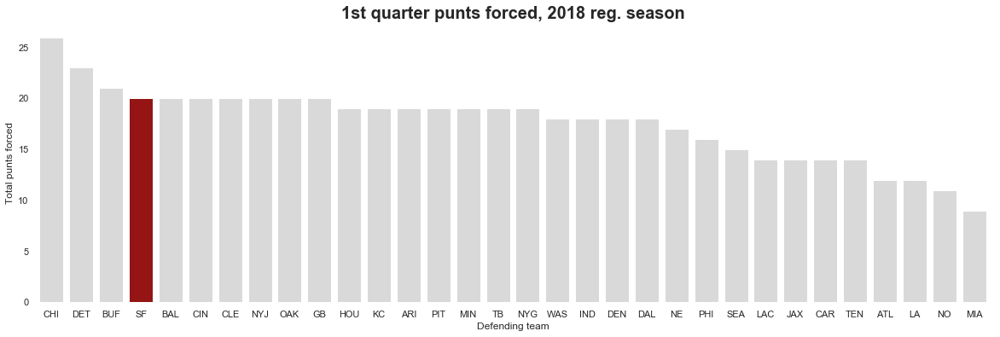

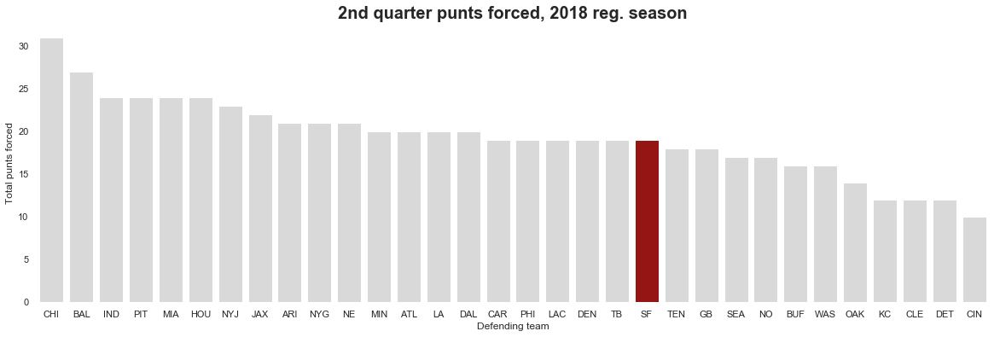

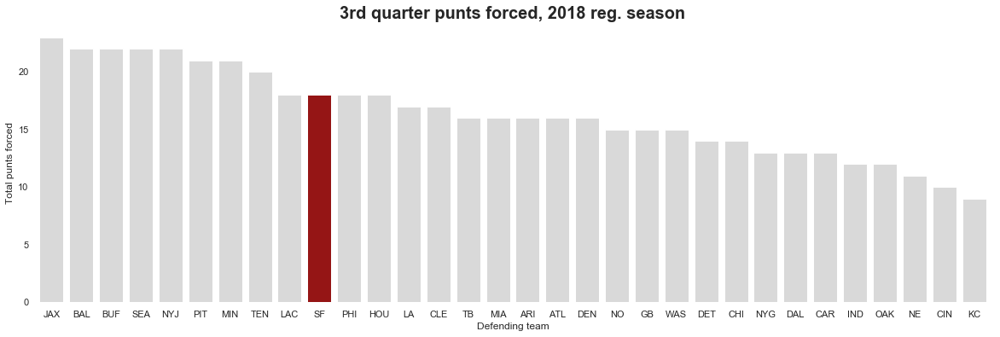

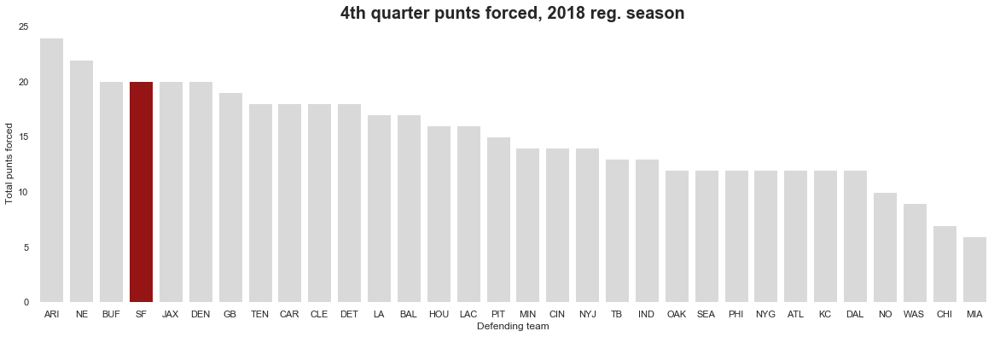

In [365]:
for i in range(1,5):
    
    data = (all_quarters_punts[all_quarters_punts['qtr'] == i]
                .groupby('defteam')['punt_forced']
                .count()
                .reset_index()
                .sort_values('punt_forced', ascending=False))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    f, ax = plt.subplots(figsize=(20, 6))
    ax = sns.barplot(x="defteam", y="punt_forced", data=data, palette=team_colors_gray)

    ax.set_ylabel('Total punts forced')
    ax.set_xlabel('Defending team')
    ax.set_title('{} quarter punts forced, 2018 reg. season'.format(quarter), fontsize=20, weight='bold')

    sns.despine(top=True, bottom=True, left=True, right=True)

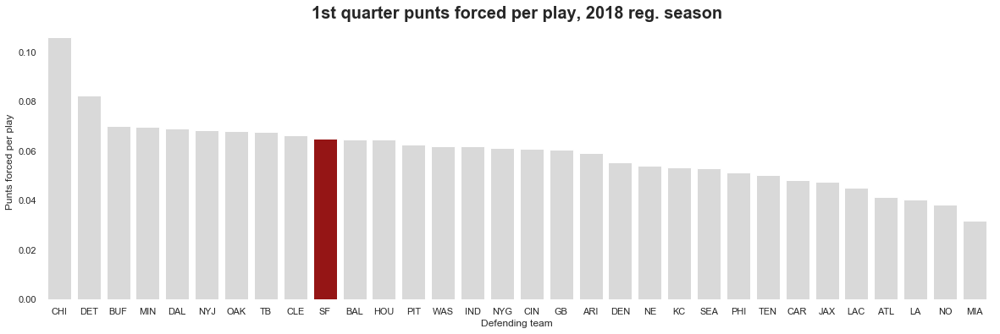

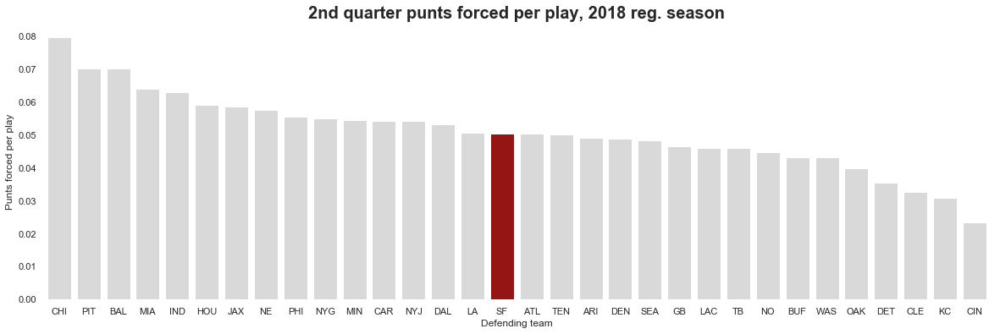

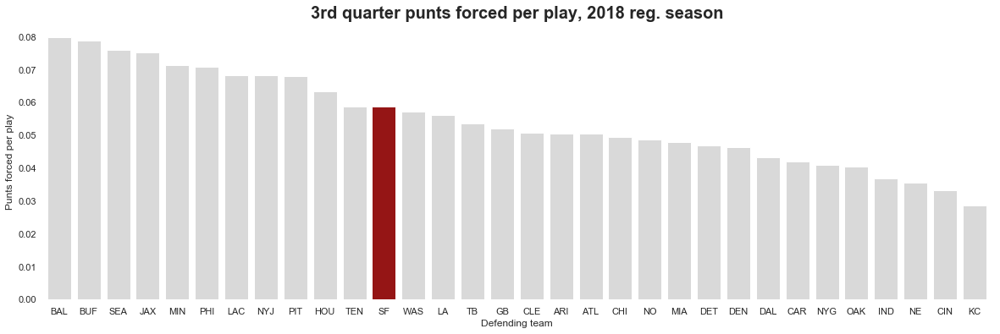

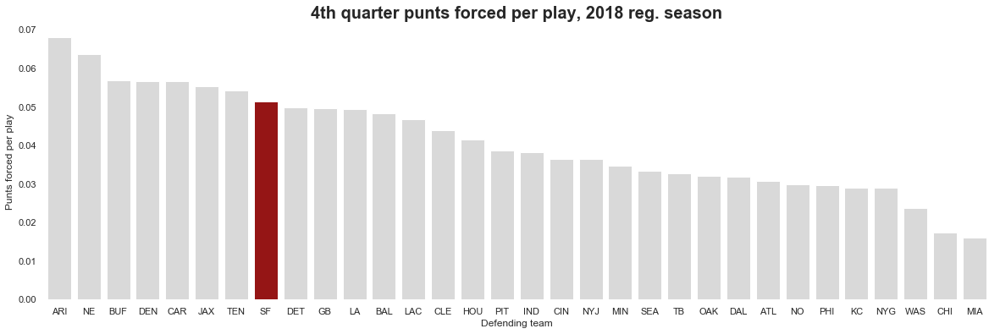

In [366]:
for i in range(1,5):
    
    data = (all_quarters[all_quarters['qtr'] == i]
                .groupby('defteam')['punt_forced']
                .mean()
                .reset_index()
                .sort_values('punt_forced', ascending=False))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    f, ax = plt.subplots(figsize=(20, 6))
    ax = sns.barplot(x="defteam", y="punt_forced", data=data, palette=team_colors_gray, alpha=1)

    ax.set_ylabel('Punts forced per play')
    ax.set_xlabel('Defending team')
    ax.set_title('{} quarter punts forced per play, 2018 reg. season'.format(quarter), fontsize=20, weight='bold')

    sns.despine(top=True, bottom=True, left=True, right=True)

## Points allowed per quarter

In [368]:
all_quarters = df.loc[:,['defteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']

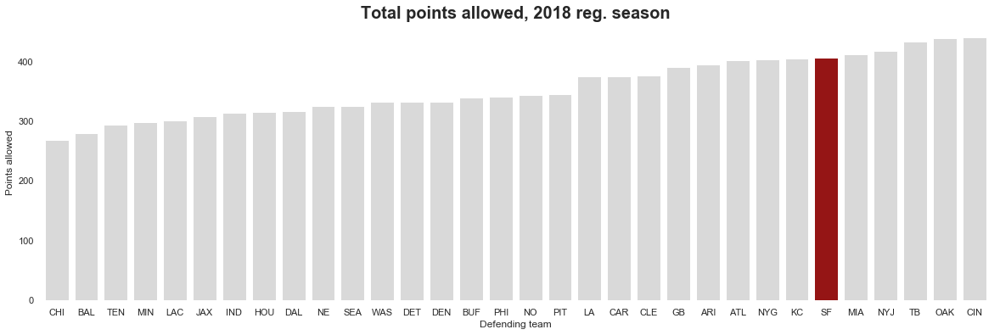

In [372]:
all_quarters_points = all_quarters.groupby('defteam')['points_scored'].sum().reset_index().sort_values('points_scored', ascending=True)

f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(x="defteam", y="points_scored", data=all_quarters_points, palette=team_colors_gray)

ax.set_ylabel('Points allowed')
ax.set_xlabel('Defending team')
ax.set_title('Total points allowed, 2018 reg. season', fontsize=20, weight='bold')

sns.despine(top=True, bottom=True, left=True, right=True)

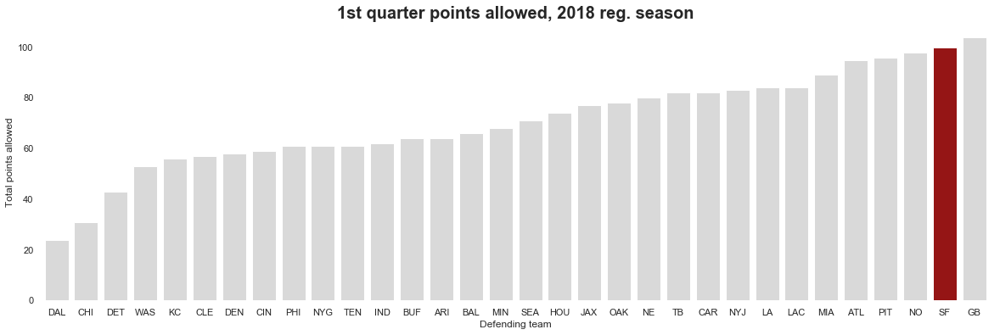

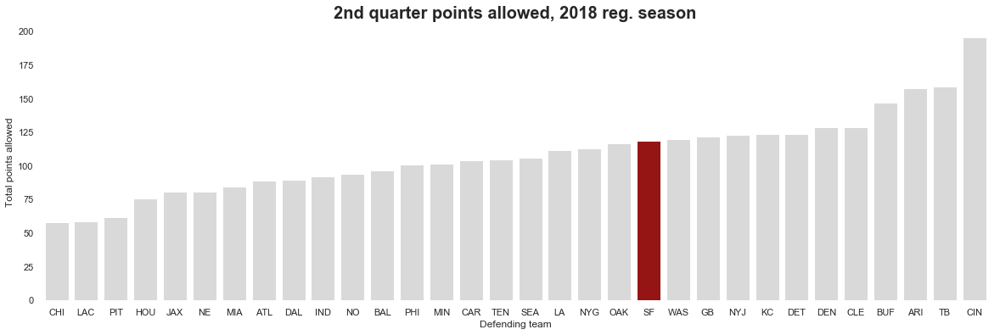

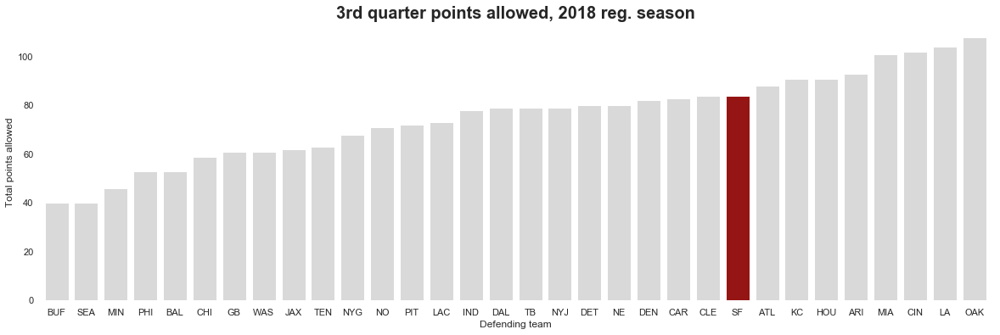

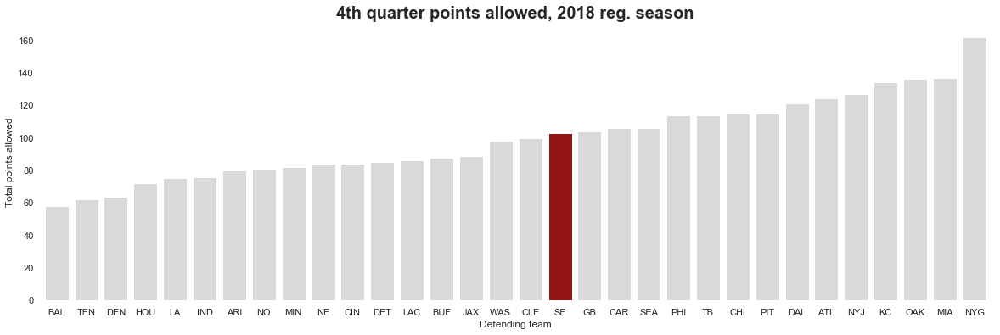

In [373]:
for i in range(1,5):
    
    data = (all_quarters[all_quarters['qtr'] == i]
                .groupby('defteam')['points_scored']
                .sum()
                .reset_index()
                .sort_values('points_scored', ascending=True))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    f, ax = plt.subplots(figsize=(20, 6))
    ax = sns.barplot(x="defteam", y="points_scored", data=data, palette=team_colors_gray)

    ax.set_ylabel('Total points allowed')
    ax.set_xlabel('Defending team')
    ax.set_title('{} quarter points allowed, 2018 reg. season'.format(quarter), fontsize=20, weight='bold')

    sns.despine(top=True, bottom=True, left=True, right=True)

## EPA allowed by defending teams

In [489]:
all_quarters = df.loc[:,['defteam', 'qtr', 'epa', 'wpa', 'game_seconds_remaining', 'play_type', 'posteam_score', 'posteam_score_post']]
all_quarters['clutch_epa'] = all_quarters['epa'] * all_quarters['wpa']
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']
all_quarters['points_scored'] = all_quarters['posteam_score_post'] - all_quarters['posteam_score']

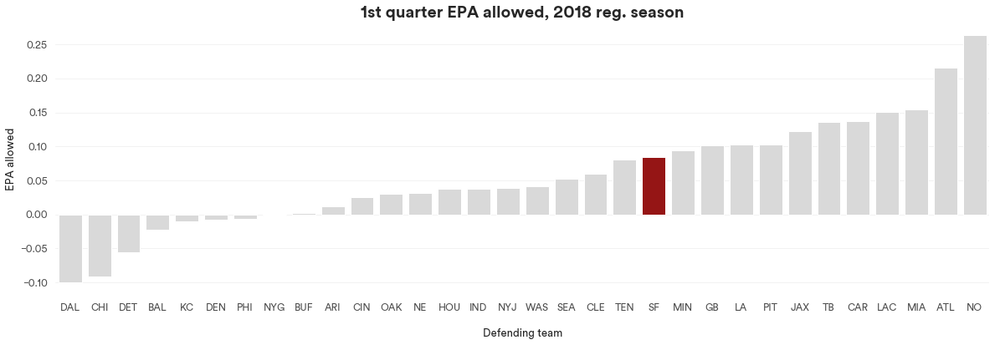

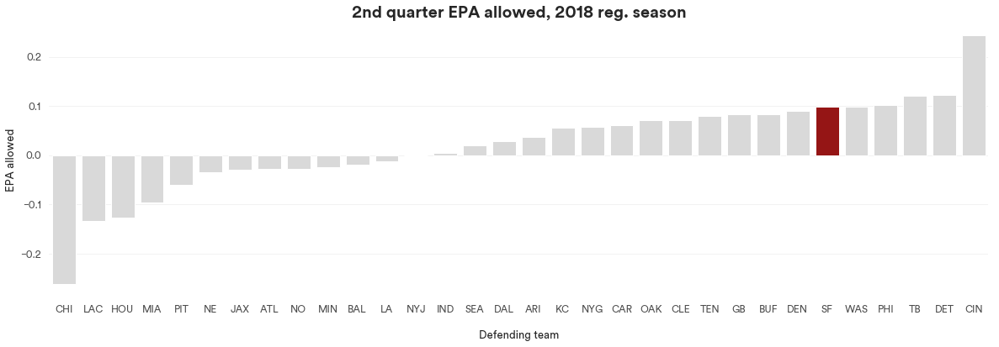

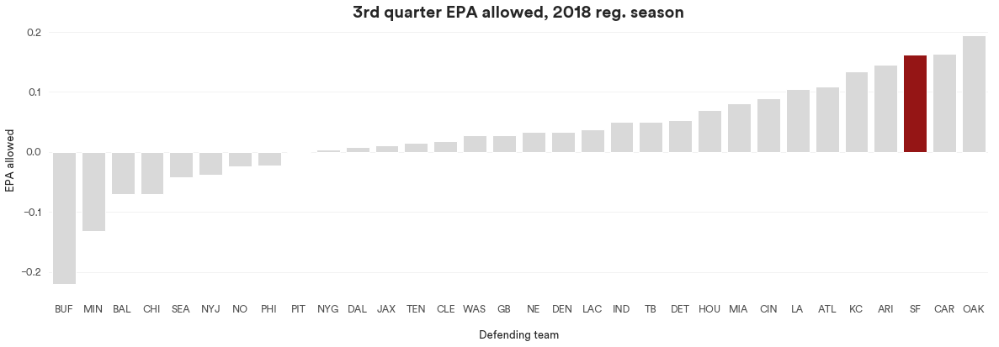

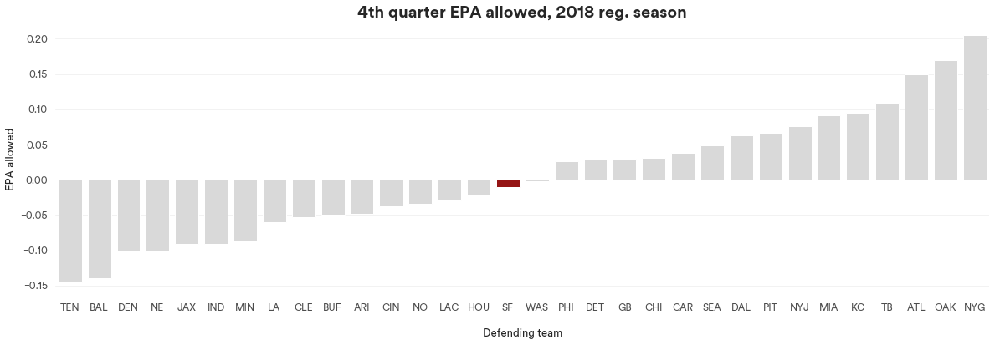

In [493]:
for i in range(1,5):
    
    data = (all_quarters[all_quarters['qtr'] == i]
                .groupby('defteam')['epa']
                .mean()
                .reset_index()
                .sort_values('epa', ascending=True))
    
    qtr_list = ['1st', '2nd', '3rd', '4th']
    quarter = qtr_list[i-1]
    
    f, ax = plt.subplots(figsize=(20, 6))
    ax = sns.barplot(x="defteam", y="epa", data=data, palette=team_colors_gray)

    ax.set_ylabel('EPA allowed')
    ax.set_xlabel('\nDefending team')
    ax.set_title('{} quarter EPA allowed, 2018 reg. season'.format(quarter), fontsize=20, weight='bold')

    sns.despine(top=True, bottom=True, left=True, right=True)

## Beathard vs Mullens vs Garoppolo in the 4th quarter

In [373]:
from datetime import datetime

season_start = datetime(2018, 9, 6)

all_quarters = df.loc[:,['posteam', 'game_date', 'qtr', 'play_type', 'epa', 'wpa', 'game_seconds_remaining', 'passer_player_name']]
all_quarters['seconds_progressed'] = 3600 - all_quarters['game_seconds_remaining']

all_quarters['game_date'] = pd.to_datetime(all_quarters['game_date'])
all_quarters['day_number'] = (all_quarters['game_date'] - season_start).dt.days

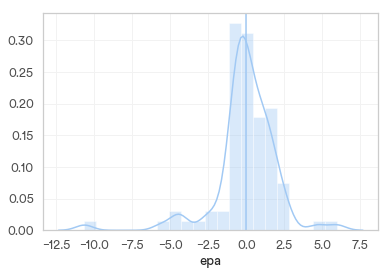

In [541]:
passer_data = all_quarters[(all_quarters['qtr'] == 4) &
             (all_quarters['play_type'] == 'pass')
            ][['passer_player_name', 'epa']].dropna()

#ax = sns.histplot(passer_data[passer_data['passer_player_name'] == 'J.Garoppolo']['epa'], label='Garoppolo', shade=True)
ax = sns.distplot(passer_data[passer_data['passer_player_name'] == 'N.Mullens']['epa'], label='Mullens')
#ax = sns.distplot(passer_data[passer_data['passer_player_name'] == 'C.Beathard']['epa'], label='Beathard')
#plt.axvline(x=passer_data[passer_data['passer_player_name'] == 'C.Beathard']['epa'].median())
plt.axvline(x=passer_data[passer_data['passer_player_name'] == 'N.Mullens']['epa'].median())

In [545]:
qualifying_passers = passer_data.groupby(['passer_player_name']).agg(['mean', 'count']).reset_index()
qualifying_passers = qualifying_passers[qualifying_passers['epa']['count'] >= 50].sort_values(('epa', 'mean'), ascending=False)
qualifying_passers = qualifying_passers['passer_player_name']
#qualifying_passers[qualifying_passers['passer_player_name'] == 'J.Garoppolo']
#qualifying_passers

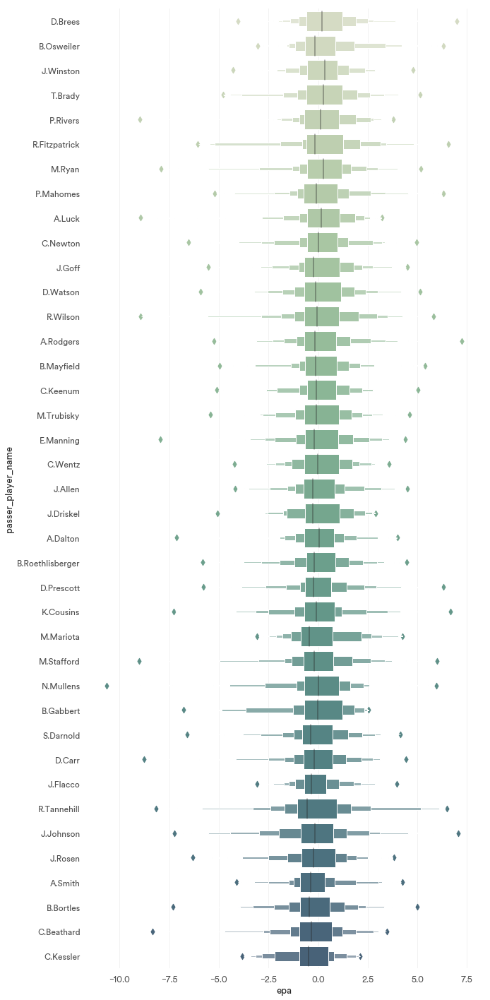

In [543]:
box_data = passer_data.copy()
box_data['passer_player_name'] = box_data['passer_player_name'].astype("category")
box_data['passer_player_name'].cat.set_categories(qualifying_passers, inplace=True)
box_data = box_data.sort_values('passer_player_name')

f, ax = plt.subplots(figsize=(10, 25))
ax = sns.boxenplot(x='epa', 
                   y='passer_player_name', 
                   data=box_data, 
                   palette=sns.cubehelix_palette(55, start=.5, rot=-.75),
                  )

#plt.xticks(rotation=90)
sns.despine(left=True, right=True, bottom=True, top=True)

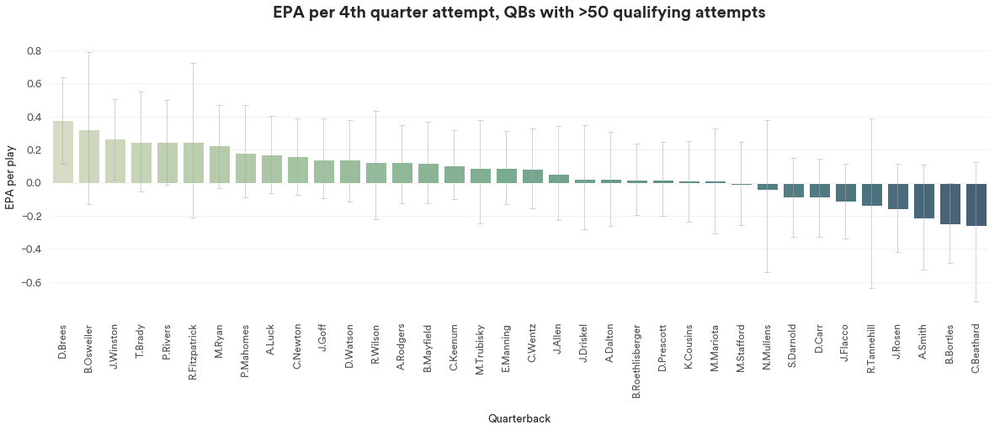

In [546]:
bar_data = passer_data.copy()
bar_data['passer_player_name'] = bar_data['passer_player_name'].astype("category")
bar_data['passer_player_name'].cat.set_categories(qualifying_passers, inplace=True)
bar_data = bar_data.sort_values('passer_player_name')

f, ax = plt.subplots(figsize=(20, 6))
ax = sns.barplot(y='epa',
                 x='passer_player_name', 
                 data=bar_data, 
                 palette=sns.cubehelix_palette(50, start=.5, rot=-.75),
                 errwidth=0.5,
                 errcolor='darkgray',
                 capsize=.2
                  )

plt.xticks(rotation=90)

ax.set_ylabel('EPA per play')
ax.set_xlabel('\nQuarterback')
ax.set_title('EPA per 4th quarter attempt, QBs with >50 qualifying attempts\n', fontsize=20, weight='bold')


sns.despine(left=True, right=True, bottom=True, top=True)

plt.savefig('output/epa/' + '4th_quarter_epa_quarterbacks' + '.png', format='png', dpi=300, bbox_inches = "tight")

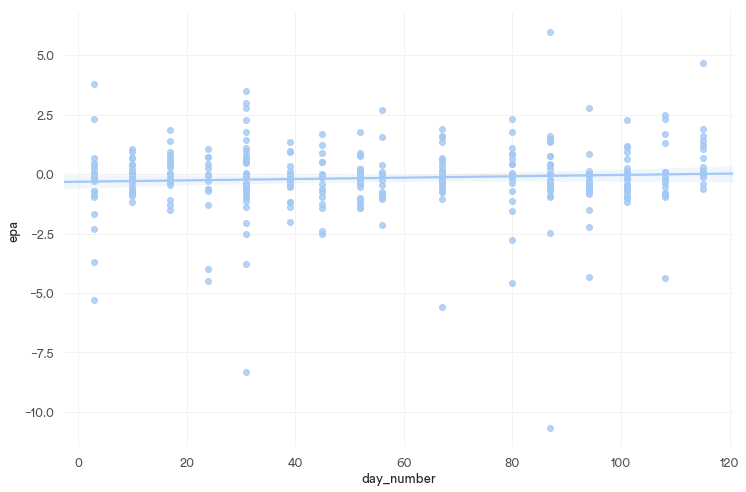

In [490]:
scatter_data =  all_quarters[(all_quarters['qtr'] == 4) &
             (all_quarters['posteam'] == 'SF')
            ][['day_number', 'epa']].dropna()

f, ax = plt.subplots(figsize=(12, 8))

ax = sns.regplot(x="day_number", y="epa", data=scatter_data)
sns.despine(left=True, right=True, bottom=True, top=True)

## Fourth quarter fumbles, sacks and TFLs

In [522]:
offensive_line = df.loc[:,['posteam', 
                           'qtr', 
                           'epa', 
                           'wpa', 
                           'game_seconds_remaining', 
                           'play_type', 
                           'tackled_for_loss',
                           'fumble',
                           'sack']]

offensive_line['fum_sack_tfl'] = (offensive_line['tackled_for_loss'] == 1) | (offensive_line['sack'] == 1)


In [527]:
offensive_line[offensive_line['qtr'] == 4].groupby('posteam')['fum_sack_tfl'].sum().reset_index().sort_values('fum_sack_tfl', ascending=False)

,posteam,fum_sack_tfl
18,MIA,32.0
27,SEA,31.0
14,JAX,31.0
28,SF,29.0
0,ARI,28.0
8,DAL,28.0
31,WAS,28.0
15,KC,26.0
1,ATL,26.0
5,CHI,25.0
